# **Object Detection using Pre-Trained Models**

### In this .ipynb Jupiter Notebook we will try some experiements with object delection using PyTorch Neural Models

## **Installing useful packages**

In [1]:
!pip install pycocotools
import pycocotools

In [2]:
from PIL import Image
from pycocotools.coco import COCO
import torch
print("PyTorch Version : {}".format(torch.__version__))
import torchvision
print("TorchVision Version : {}".format(torchvision.__version__))
from torchvision.transforms.functional import pil_to_tensor
from torchvision.utils import draw_bounding_boxes
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from torchvision.models.detection import *
from torchvision.models.detection.fcos import FCOS
from torchvision.models.detection.retinanet import RetinaNet
from torchvision.models.detection.keypoint_rcnn import KeypointRCNN
from torchvision.models.detection.mask_rcnn import MaskRCNN
from torchvision import models
from torchvision.models.segmentation import *
import timm

PyTorch Version : 2.8.0+cu126
TorchVision Version : 0.23.0+cu126


## **Load Sample Images**

In [3]:
!wget https://images.click.in/classifieds/images/95/30_12_2017_15_58_25_562aaa7a9b6593ce55f7e59cae781674_vpwodzncbi.jpg
!wget https://gumlet.assettype.com/freepressjournal/import/2016/07/kids-playing.jpg

--2025-10-29 16:17:58--  https://images.click.in/classifieds/images/95/30_12_2017_15_58_25_562aaa7a9b6593ce55f7e59cae781674_vpwodzncbi.jpg
Resolving images.click.in (images.click.in)... 172.64.155.26, 104.18.32.230, 2606:4700:4403::6812:20e6, ...
Connecting to images.click.in (images.click.in)|172.64.155.26|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://www.click.in/classifieds/images/95/30_12_2017_15_58_25_562aaa7a9b6593ce55f7e59cae781674_vpwodzncbi.jpg [following]
--2025-10-29 16:17:59--  https://www.click.in/classifieds/images/95/30_12_2017_15_58_25_562aaa7a9b6593ce55f7e59cae781674_vpwodzncbi.jpg
Resolving www.click.in (www.click.in)... 172.64.155.26, 104.18.32.230, 2a06:98c1:3107::ac40:9b1a, ...
Connecting to www.click.in (www.click.in)|172.64.155.26|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 61629 (60K) [image/jpeg]
Saving to: ‘30_12_2017_15_58_25_562aaa7a9b6593ce55f7e59cae781674_vpwodzncbi.jpg’

30

### **Download Sample Images**

### **Load Images as Pillow Images**

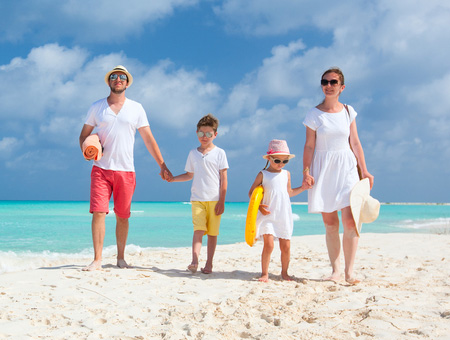

In [4]:
holiday = Image.open("holiday.jpg")
holiday

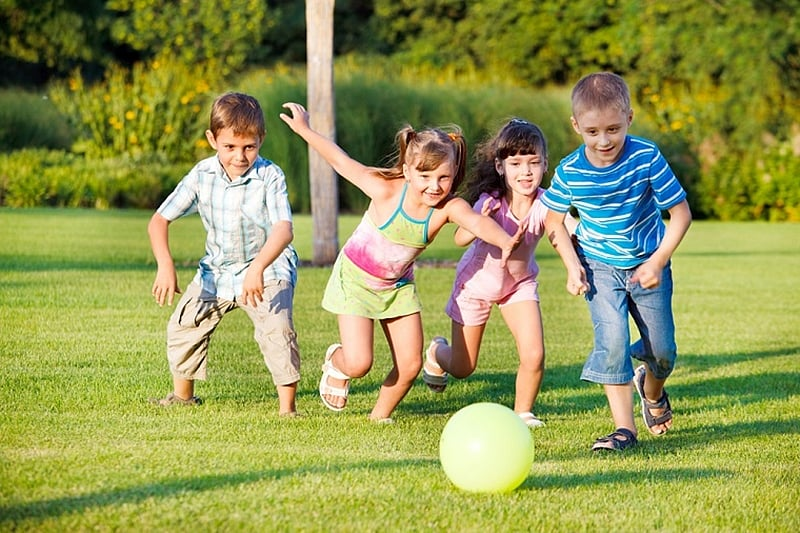

In [5]:
kids_playing = Image.open("kids-playing.jpg")
kids_playing

### **Convert Pillow Images to Torch Tensors**

In [6]:
holiday_tensor_int = pil_to_tensor(holiday)
kids_playing_tensor_int = pil_to_tensor(kids_playing)
holiday_tensor_int.shape, kids_playing_tensor_int.shape

(torch.Size([3, 340, 450]), torch.Size([3, 533, 800]))

### **Add Batch Dimension**

In [7]:
holiday_tensor_int = holiday_tensor_int.unsqueeze(dim=0)
kids_playing_tensor_int = kids_playing_tensor_int.unsqueeze(dim=0)
holiday_tensor_int.shape, kids_playing_tensor_int.shape

(torch.Size([1, 3, 340, 450]), torch.Size([1, 3, 533, 800]))

### **Convert Images Represented as Integer (0-255) to Floats (0-1)**

In [8]:
print(holiday_tensor_int.min(), holiday_tensor_int.max())
holiday_tensor_float = holiday_tensor_int / 255.0
kids_playing_tensor_float = kids_playing_tensor_int / 255.0
print(holiday_tensor_float.min(), holiday_tensor_float.max())

tensor(0, dtype=torch.uint8) tensor(255, dtype=torch.uint8)
tensor(0.) tensor(1.)


## **Load Pre-Trained PyTorch Model**

### **Faster R-CNN with ResNet50 Backbone**

In [9]:
object_detection_model = fasterrcnn_resnet50_fpn(pretrained=True, progress=False)
object_detection_model.eval(); ## Setting Model for Evaluation/Prediction

/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth


## **Make Predictions**

In [10]:
holiday_preds = object_detection_model(holiday_tensor_float)
holiday_preds

[{'boxes': tensor([[ 77.3332,  64.9794, 175.3670, 271.5141],
          [298.0679,  70.5143, 376.4788, 284.1354],
          [245.2463, 139.0267, 317.0148, 283.9666],
          [159.3096, 112.5193, 227.8741, 275.4442],
          [259.4892, 203.4593, 270.6147, 215.5286],
          [244.8179, 185.8645, 264.0523, 245.4252],
          [ 82.5829, 134.4643, 102.1377, 160.6974],
          [ 82.8002, 137.4602, 101.8921, 160.4365],
          [ 83.7411, 142.8226,  99.1271, 159.4648],
          [291.8988, 213.4655, 299.3017, 220.6194],
          [349.4891, 178.3998, 376.2213, 225.5979],
          [245.0582, 182.9447, 263.7845, 247.4626],
          [261.6564, 202.7800, 269.9642, 211.0025]], grad_fn=<StackBackward0>),
  'labels': tensor([ 1,  1,  1,  1, 34, 34, 37, 34, 37, 37, 34, 42, 34]),
  'scores': tensor([0.9998, 0.9997, 0.9996, 0.9995, 0.9752, 0.8967, 0.8015, 0.5139, 0.4637,
          0.3935, 0.3100, 0.2014, 0.0652], grad_fn=<IndexBackward0>)}]

In [11]:
holiday_preds[0]["boxes"] = holiday_preds[0]["boxes"][holiday_preds[0]["scores"] > 0.8]
holiday_preds[0]["labels"] = holiday_preds[0]["labels"][holiday_preds[0]["scores"] > 0.8]
holiday_preds[0]["scores"] = holiday_preds[0]["scores"][holiday_preds[0]["scores"] > 0.8]

holiday_preds

[{'boxes': tensor([[ 77.3332,  64.9794, 175.3670, 271.5141],
          [298.0679,  70.5143, 376.4788, 284.1354],
          [245.2463, 139.0267, 317.0148, 283.9666],
          [159.3096, 112.5193, 227.8741, 275.4442],
          [259.4892, 203.4593, 270.6147, 215.5286],
          [244.8179, 185.8645, 264.0523, 245.4252],
          [ 82.5829, 134.4643, 102.1377, 160.6974]], grad_fn=<IndexBackward0>),
  'labels': tensor([ 1,  1,  1,  1, 34, 34, 37]),
  'scores': tensor([0.9998, 0.9997, 0.9996, 0.9995, 0.9752, 0.8967, 0.8015],
         grad_fn=<IndexBackward0>)}]

In [12]:
kids_preds = object_detection_model(kids_playing_tensor_float)

kids_preds

[{'boxes': tensor([[143.6319,  93.2323, 308.2031, 414.8836],
          [532.6088,  70.2206, 691.4143, 454.9586],
          [286.7328, 105.8084, 479.5358, 419.2754],
          [421.6546, 115.6178, 564.2560, 425.6817],
          [437.7904, 403.2669, 534.6056, 496.4609],
          [436.8823, 123.7119, 468.2822, 196.5514],
          [437.8317, 400.6743, 537.7145, 498.1171],
          [420.9793, 129.7272, 478.9899, 374.4555]], grad_fn=<StackBackward0>),
  'labels': tensor([ 1,  1,  1,  1, 37,  1, 34,  1]),
  'scores': tensor([0.9998, 0.9998, 0.9982, 0.9975, 0.9860, 0.0996, 0.0647, 0.0616],
         grad_fn=<IndexBackward0>)}]

In [13]:
kids_preds[0]["boxes"] = kids_preds[0]["boxes"][kids_preds[0]["scores"] > 0.8]
kids_preds[0]["labels"] = kids_preds[0]["labels"][kids_preds[0]["scores"] > 0.8]
kids_preds[0]["scores"] = kids_preds[0]["scores"][kids_preds[0]["scores"] > 0.8]

kids_preds

[{'boxes': tensor([[143.6319,  93.2323, 308.2031, 414.8836],
          [532.6088,  70.2206, 691.4143, 454.9586],
          [286.7328, 105.8084, 479.5358, 419.2754],
          [421.6546, 115.6178, 564.2560, 425.6817],
          [437.7904, 403.2669, 534.6056, 496.4609]], grad_fn=<IndexBackward0>),
  'labels': tensor([ 1,  1,  1,  1, 37]),
  'scores': tensor([0.9998, 0.9998, 0.9982, 0.9975, 0.9860], grad_fn=<IndexBackward0>)}]

## **Visualize Results**

### **Load Target Classes Mapping**

In [14]:
!wget http://images.cocodataset.org/annotations/annotations_trainval2017.zip
!unzip annotations_trainval2017.zip

--2025-10-29 16:18:42--  http://images.cocodataset.org/annotations/annotations_trainval2017.zip
Resolving images.cocodataset.org (images.cocodataset.org)... 3.5.8.131, 54.231.204.97, 54.231.198.129, ...
Connecting to images.cocodataset.org (images.cocodataset.org)|3.5.8.131|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 252907541 (241M) [application/zip]
Saving to: ‘annotations_trainval2017.zip’

annotations_trainva 100%[===================>] 241.19M  59.6MB/s    in 4.5s    

2025-10-29 16:18:47 (53.8 MB/s) - ‘annotations_trainval2017.zip’ saved [252907541/252907541]

Archive:  annotations_trainval2017.zip
  inflating: annotations/instances_train2017.json  
  inflating: annotations/instances_val2017.json  
  inflating: annotations/captions_train2017.json  
  inflating: annotations/captions_val2017.json  
  inflating: annotations/person_keypoints_train2017.json  
  inflating: annotations/person_keypoints_val2017.json  


In [15]:
annFile='annotations/instances_val2017.json'

coco=COCO(annFile)

loading annotations into memory...
Done (t=0.52s)
creating index...
index created!


### **Map Target Category Ids to Labels**

In [16]:
holiday_labels = coco.loadCats(holiday_preds[0]["labels"].numpy())

holiday_labels

[{'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'sports', 'id': 34, 'name': 'frisbee'},
 {'supercategory': 'sports', 'id': 34, 'name': 'frisbee'},
 {'supercategory': 'sports', 'id': 37, 'name': 'sports ball'}]

In [17]:
kids_labels = coco.loadCats(kids_preds[0]["labels"].numpy())

kids_labels

[{'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'sports', 'id': 37, 'name': 'sports ball'}]

### **Visualize Bounding Boxes On Original Images**

In [18]:
holiday_annot_labels = ["{}-{:.2f}".format(label["name"], prob) for label, prob in zip(holiday_labels, holiday_preds[0]["scores"].detach().numpy())]

holiday_output = draw_bounding_boxes(image=holiday_tensor_int[0],
                             boxes=holiday_preds[0]["boxes"],
                             labels=holiday_annot_labels,
                             colors=["red" if label["name"]=="person" else "green" for label in holiday_labels],
                             width=2
                            )

holiday_output.shape

torch.Size([3, 340, 450])

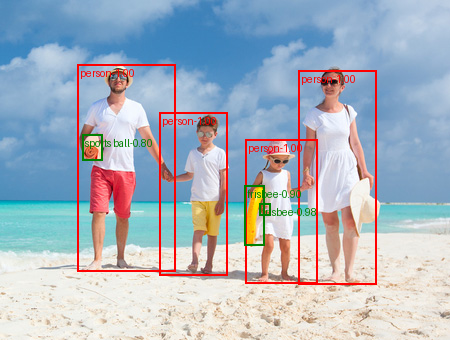

In [19]:
from torchvision.transforms.functional import to_pil_image
to_pil_image(holiday_output)

/usr/local/lib/python3.12/dist-packages/torchvision/utils.py:367: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


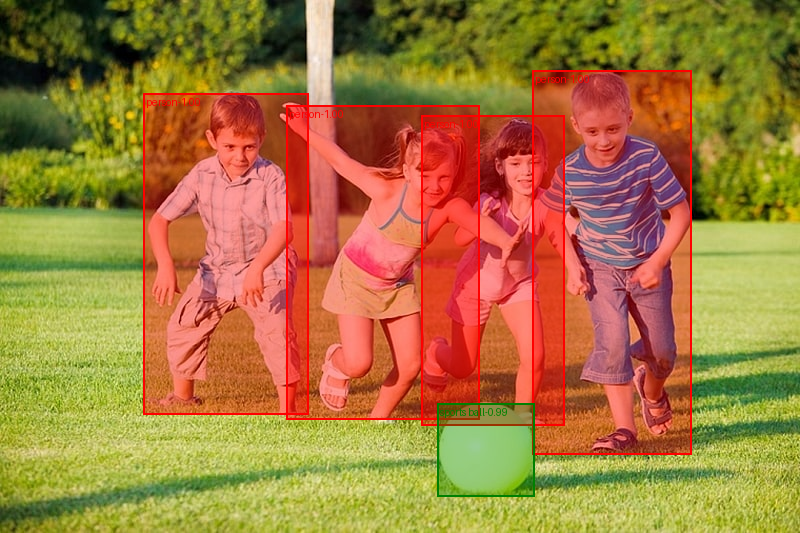

In [20]:
kids_annot_labels = ["{}-{:.2f}".format(label["name"], prob) for label, prob in zip(kids_labels, kids_preds[0]["scores"].detach().numpy())]

kids_output = draw_bounding_boxes(image=kids_playing_tensor_int[0],
                             boxes=kids_preds[0]["boxes"],
                             labels=kids_annot_labels,
                             colors=["red" if label["name"]=="person" else "green" for label in kids_labels],
                             width=2,
                             font_size=16,
                             fill=True
                            )

to_pil_image(kids_output)

## **Try Other Pre-Trained Models**

### Here we are testing other detection models, such as fasterrcnn_mobilenet_v3_large_320_fpn, fasterrcnn_mobilenet_v3_large_fpn, fcos_resnet50_fpn, ssdlite320_mobilenet_v3_large, ssd300_vgg16, retinanet_resnet50_fpn, maskrcnn_resnet50_fpn, keypointrcnn_resnet50_fpn

In [21]:
from torchvision.models.detection import fasterrcnn_mobilenet_v3_large_320_fpn,\
                                         fasterrcnn_mobilenet_v3_large_fpn,\
                                         fcos_resnet50_fpn,\
                                         ssdlite320_mobilenet_v3_large,\
                                         ssd300_vgg16,\
                                         retinanet_resnet50_fpn

In [29]:
import torch
from torchvision.models.detection import *
from torchvision import models
from torchvision.models.segmentation import *
import timm

# Детекция объектов - ОБНОВЛЕНО на новый API
object_detection_model_1 = fasterrcnn_mobilenet_v3_large_320_fpn(weights="DEFAULT", progress=False)
object_detection_model_1.eval()

object_detection_model_2 = fasterrcnn_mobilenet_v3_large_fpn(weights="DEFAULT", progress=False)
object_detection_model_2.eval()

object_detection_model_3 = fcos_resnet50_fpn(weights="DEFAULT", progress=False)
object_detection_model_3.eval()

object_detection_model_4 = ssdlite320_mobilenet_v3_large(weights="DEFAULT", progress=False)
object_detection_model_4.eval()

object_detection_model_5 = ssd300_vgg16(weights="DEFAULT", progress=False)
object_detection_model_5.eval()

object_detection_model_6 = retinanet_resnet50_fpn(weights="DEFAULT", progress=False)
object_detection_model_6.eval()

object_detection_model_7 = maskrcnn_resnet50_fpn(weights="DEFAULT", progress=False)
object_detection_model_7.eval()

object_detection_model_8 = keypointrcnn_resnet50_fpn(weights="DEFAULT", progress=False)
object_detection_model_8.eval()

# Классификация - все torchvision модели используют weights="DEFAULT"
# resnet18_model = models.resnet18(weights="DEFAULT", progress=False)
# resnet18_model.eval()
# resnet34_model = models.resnet34(weights="DEFAULT", progress=False)
# resnet34_model.eval()
# resnet50_model = models.resnet50(weights="DEFAULT", progress=False)
# resnet50_model.eval()
# resnet101_model = models.resnet101(weights="DEFAULT", progress=False)
# resnet101_model.eval()
# resnet152_model = models.resnet152(weights="DEFAULT", progress=False)
# resnet152_model.eval()

# # EfficientNet
# efficientnet_b0_model = models.efficientnet_b0(weights="DEFAULT", progress=False)
# efficientnet_b0_model.eval()
# efficientnet_b1_model = models.efficientnet_b1(weights="DEFAULT", progress=False)
# efficientnet_b1_model.eval()
# efficientnet_b2_model = models.efficientnet_b2(weights="DEFAULT", progress=False)
# efficientnet_b2_model.eval()
# efficientnet_b3_model = models.efficientnet_b3(weights="DEFAULT", progress=False)
# efficientnet_b3_model.eval()
# efficientnet_b4_model = models.efficientnet_b4(weights="DEFAULT", progress=False)
# efficientnet_b4_model.eval()
# efficientnet_b5_model = models.efficientnet_b5(weights="DEFAULT", progress=False)
# efficientnet_b5_model.eval()
# efficientnet_b6_model = models.efficientnet_b6(weights="DEFAULT", progress=False)
# efficientnet_b6_model.eval()
# efficientnet_b7_model = models.efficientnet_b7(weights="DEFAULT", progress=False)
# efficientnet_b7_model.eval()

# # Vision Transformer
# vit_b_16_model = models.vit_b_16(weights="DEFAULT", progress=False)
# vit_b_16_model.eval()
# vit_b_32_model = models.vit_b_32(weights="DEFAULT", progress=False)
# vit_b_32_model.eval()
# vit_l_16_model = models.vit_l_16(weights="DEFAULT", progress=False)
# vit_l_16_model.eval()
# vit_l_32_model = models.vit_l_32(weights="DEFAULT", progress=False)
# vit_l_32_model.eval()
# vit_h_14_model = models.vit_h_14(weights="DEFAULT", progress=False)
# vit_h_14_model.eval()

# # Swin Transformer
# swin_t_model = models.swin_t(weights="DEFAULT", progress=False)
# swin_t_model.eval()
# swin_s_model = models.swin_s(weights="DEFAULT", progress=False)
# swin_s_model.eval()
# swin_b_model = models.swin_b(weights="DEFAULT", progress=False)
# swin_b_model.eval()
# swin_v2_t_model = models.swin_v2_t(weights="DEFAULT", progress=False)
# swin_v2_t_model.eval()
# swin_v2_s_model = models.swin_v2_s(weights="DEFAULT", progress=False)
# swin_v2_s_model.eval()
# swin_v2_b_model = models.swin_v2_b(weights="DEFAULT", progress=False)
# swin_v2_b_model.eval()

# # MobileNet
# mobilenet_v3_small_model = models.mobilenet_v3_small(weights="DEFAULT", progress=False)
# mobilenet_v3_small_model.eval()
# mobilenet_v3_large_model = models.mobilenet_v3_large(weights="DEFAULT", progress=False)
# mobilenet_v3_large_model.eval()

# # DenseNet
# densenet121_model = models.densenet121(weights="DEFAULT", progress=False)
# densenet121_model.eval()
# densenet161_model = models.densenet161(weights="DEFAULT", progress=False)
# densenet161_model.eval()
# densenet169_model = models.densenet169(weights="DEFAULT", progress=False)
# densenet169_model.eval()
# densenet201_model = models.densenet201(weights="DEFAULT", progress=False)
# densenet201_model.eval()

# # VGG
# vgg11_model = models.vgg11(weights="DEFAULT", progress=False)
# vgg11_model.eval()
# vgg13_model = models.vgg13(weights="DEFAULT", progress=False)
# vgg13_model.eval()
# vgg16_model = models.vgg16(weights="DEFAULT", progress=False)
# vgg16_model.eval()
# vgg19_model = models.vgg19(weights="DEFAULT", progress=False)
# vgg19_model.eval()

# # Inception
# inception_v3_model = models.inception_v3(weights="DEFAULT", progress=False)
# inception_v3_model.eval()

# # AlexNet
# alexnet_model = models.alexnet(weights="DEFAULT", progress=False)
# alexnet_model.eval()

# # GoogleNet
# googlenet_model = models.googlenet(weights="DEFAULT", progress=False)
# googlenet_model.eval()

# # ShuffleNet
# shufflenet_v2_x0_5_model = models.shufflenet_v2_x0_5(weights="DEFAULT", progress=False)
# shufflenet_v2_x0_5_model.eval()
# shufflenet_v2_x1_0_model = models.shufflenet_v2_x1_0(weights="DEFAULT", progress=False)
# shufflenet_v2_x1_0_model.eval()

# # Сегментация - ИСПРАВЛЕНО: используем разные имена для моделей
# fcn_resnet50_model = fcn_resnet50(weights="DEFAULT", progress=False)
# fcn_resnet50_model.eval()

# fcn_resnet101_model = fcn_resnet101(weights="DEFAULT", progress=False)
# fcn_resnet101_model.eval()

# deeplabv3_resnet50_model = deeplabv3_resnet50(weights="DEFAULT", progress=False)
# deeplabv3_resnet50_model.eval()

# deeplabv3_resnet101_model = deeplabv3_resnet101(weights="DEFAULT", progress=False)
# deeplabv3_resnet101_model.eval()

# deeplabv3_mobilenet_v3_large_model = deeplabv3_mobilenet_v3_large(weights="DEFAULT", progress=False)
# deeplabv3_mobilenet_v3_large_model.eval()

# lraspp_mobilenet_v3_large_model = lraspp_mobilenet_v3_large(weights="DEFAULT", progress=False)
# lraspp_mobilenet_v3_large_model.eval()

# # Timm модели - используют свой API с pretrained=True
# convnext_tiny_model = timm.create_model('convnext_tiny', pretrained=True)
# convnext_tiny_model.eval()
# convnext_small_model = timm.create_model('convnext_small', pretrained=True)
# convnext_small_model.eval()
# convnext_base_model = timm.create_model('convnext_base', pretrained=True)
# convnext_base_model.eval()
# convnext_large_model = timm.create_model('convnext_large', pretrained=True)
# convnext_large_model.eval()

# # EfficientNet V2
# efficientnetv2_s_model = timm.create_model('efficientnetv2_s', pretrained=False)  # Исправлено на True
# efficientnetv2_s_model.eval()
# efficientnetv2_m_model = timm.create_model('efficientnetv2_m', pretrained=False)
# efficientnetv2_m_model.eval()
# efficientnetv2_l_model = timm.create_model('efficientnetv2_l', pretrained=False)
# efficientnetv2_l_model.eval()

# # BEiT (Transformer)
# beit_base_patch16_model = timm.create_model('beit_base_patch16_224', pretrained=True)
# beit_base_patch16_model.eval()

# RegNet
# regnet_y_400mf_model = timm.create_model('regnetv_400mf', pretrained=True)
# regnet_y_400mf_model.eval()
# regnet_y_800mf_model = timm.create_model('regnetv_800mf', pretrained=True)
# regnet_y_800mf_model.eval()

print("Все модели успешно созданы!")


Все модели успешно созданы!


## **Analysing most PyTorch models and divide them to different groups (Classifing, Detection and Segmentation)**

In [22]:
import torch
from torchvision import models
from torchvision.models.detection import *
from torchvision.models.segmentation import *
import timm

def create_all_models():
    """Создаем все возможные модели torchvision"""
    all_models = {}

    # ===== ДЕТЕКЦИЯ ОБЪЕКТОВ =====
    try:
        all_models['fasterrcnn_resnet50_fpn'] = fasterrcnn_resnet50_fpn(weights="DEFAULT", progress=False)
        all_models['fasterrcnn_mobilenet_v3_large_320_fpn'] = fasterrcnn_mobilenet_v3_large_320_fpn(weights="DEFAULT", progress=False)
        all_models['fasterrcnn_mobilenet_v3_large_fpn'] = fasterrcnn_mobilenet_v3_large_fpn(weights="DEFAULT", progress=False)
        all_models['fcos_resnet50_fpn'] = fcos_resnet50_fpn(weights="DEFAULT", progress=False)
        all_models['ssdlite320_mobilenet_v3_large'] = ssdlite320_mobilenet_v3_large(weights="DEFAULT", progress=False)
        all_models['ssd300_vgg16'] = ssd300_vgg16(weights="DEFAULT", progress=False)
        all_models['retinanet_resnet50_fpn'] = retinanet_resnet50_fpn(weights="DEFAULT", progress=False)
        all_models['maskrcnn_resnet50_fpn'] = maskrcnn_resnet50_fpn(weights="DEFAULT", progress=False)
        all_models['keypointrcnn_resnet50_fpn'] = keypointrcnn_resnet50_fpn(weights="DEFAULT", progress=False)
    except Exception as e:
        print(f"Ошибка создания моделей детекции: {e}")

    # ===== КЛАССИФИКАЦИЯ =====
    # ResNet
    try:
        all_models['resnet18'] = models.resnet18(weights="DEFAULT", progress=False)
        all_models['resnet34'] = models.resnet34(weights="DEFAULT", progress=False)
        all_models['resnet50'] = models.resnet50(weights="DEFAULT", progress=False)
        all_models['resnet101'] = models.resnet101(weights="DEFAULT", progress=False)
        all_models['resnet152'] = models.resnet152(weights="DEFAULT", progress=False)

        # Wide ResNet
        all_models['wide_resnet50_2'] = models.wide_resnet50_2(weights="DEFAULT", progress=False)
        all_models['wide_resnet101_2'] = models.wide_resnet101_2(weights="DEFAULT", progress=False)
    except Exception as e:
        print(f"Ошибка создания ResNet: {e}")

    # EfficientNet
    try:
        all_models['efficientnet_b0'] = models.efficientnet_b0(weights="DEFAULT", progress=False)
        all_models['efficientnet_b1'] = models.efficientnet_b1(weights="DEFAULT", progress=False)
        all_models['efficientnet_b2'] = models.efficientnet_b2(weights="DEFAULT", progress=False)
        all_models['efficientnet_b3'] = models.efficientnet_b3(weights="DEFAULT", progress=False)
        all_models['efficientnet_b4'] = models.efficientnet_b4(weights="DEFAULT", progress=False)
        all_models['efficientnet_b5'] = models.efficientnet_b5(weights="DEFAULT", progress=False)
        all_models['efficientnet_b6'] = models.efficientnet_b6(weights="DEFAULT", progress=False)
        all_models['efficientnet_b7'] = models.efficientnet_b7(weights="DEFAULT", progress=False)
    except Exception as e:
        print(f"Ошибка создания EfficientNet: {e}")

    # Vision Transformer
    try:
        all_models['vit_b_16'] = models.vit_b_16(weights="DEFAULT", progress=False)
        all_models['vit_b_32'] = models.vit_b_32(weights="DEFAULT", progress=False)
        all_models['vit_l_16'] = models.vit_l_16(weights="DEFAULT", progress=False)
        all_models['vit_l_32'] = models.vit_l_32(weights="DEFAULT", progress=False)
        all_models['vit_h_14'] = models.vit_h_14(weights="DEFAULT", progress=False)
    except Exception as e:
        print(f"Ошибка создания ViT: {e}")

    # Swin Transformer
    try:
        all_models['swin_t'] = models.swin_t(weights="DEFAULT", progress=False)
        all_models['swin_s'] = models.swin_s(weights="DEFAULT", progress=False)
        all_models['swin_b'] = models.swin_b(weights="DEFAULT", progress=False)
        all_models['swin_v2_t'] = models.swin_v2_t(weights="DEFAULT", progress=False)
        all_models['swin_v2_s'] = models.swin_v2_s(weights="DEFAULT", progress=False)
        all_models['swin_v2_b'] = models.swin_v2_b(weights="DEFAULT", progress=False)
    except Exception as e:
        print(f"Ошибка создания Swin: {e}")

    # MobileNet
    try:
        all_models['mobilenet_v3_small'] = models.mobilenet_v3_small(weights="DEFAULT", progress=False)
        all_models['mobilenet_v3_large'] = models.mobilenet_v3_large(weights="DEFAULT", progress=False)
    except Exception as e:
        print(f"Ошибка создания MobileNet: {e}")

    # DenseNet
    try:
        all_models['densenet121'] = models.densenet121(weights="DEFAULT", progress=False)
        all_models['densenet161'] = models.densenet161(weights="DEFAULT", progress=False)
        all_models['densenet169'] = models.densenet169(weights="DEFAULT", progress=False)
        all_models['densenet201'] = models.densenet201(weights="DEFAULT", progress=False)
    except Exception as e:
        print(f"Ошибка создания DenseNet: {e}")

    # VGG
    try:
        all_models['vgg11'] = models.vgg11(weights="DEFAULT", progress=False)
        all_models['vgg13'] = models.vgg13(weights="DEFAULT", progress=False)
        all_models['vgg16'] = models.vgg16(weights="DEFAULT", progress=False)
        all_models['vgg19'] = models.vgg19(weights="DEFAULT", progress=False)

        # VGG with BN
        all_models['vgg11_bn'] = models.vgg11_bn(weights="DEFAULT", progress=False)
        all_models['vgg13_bn'] = models.vgg13_bn(weights="DEFAULT", progress=False)
        all_models['vgg16_bn'] = models.vgg16_bn(weights="DEFAULT", progress=False)
        all_models['vgg19_bn'] = models.vgg19_bn(weights="DEFAULT", progress=False)
    except Exception as e:
        print(f"Ошибка создания VGG: {e}")

    # Другие классификаторы
    try:
        all_models['inception_v3'] = models.inception_v3(weights="DEFAULT", progress=False)
        all_models['alexnet'] = models.alexnet(weights="DEFAULT", progress=False)
        all_models['googlenet'] = models.googlenet(weights="DEFAULT", progress=False)
        all_models['shufflenet_v2_x0_5'] = models.shufflenet_v2_x0_5(weights="DEFAULT", progress=False)
        all_models['shufflenet_v2_x1_0'] = models.shufflenet_v2_x1_0(weights="DEFAULT", progress=False)
        all_models['squeezenet1_0'] = models.squeezenet1_0(weights="DEFAULT", progress=False)
        all_models['squeezenet1_1'] = models.squeezenet1_1(weights="DEFAULT", progress=False)
    except Exception as e:
        print(f"Ошибка создания других классификаторов: {e}")

    # ===== СЕГМЕНТАЦИЯ =====
    try:
        all_models['fcn_resnet50'] = fcn_resnet50(weights="DEFAULT", progress=False)
        all_models['fcn_resnet101'] = fcn_resnet101(weights="DEFAULT", progress=False)
        all_models['deeplabv3_resnet50'] = deeplabv3_resnet50(weights="DEFAULT", progress=False)
        all_models['deeplabv3_resnet101'] = deeplabv3_resnet101(weights="DEFAULT", progress=False)
        all_models['deeplabv3_mobilenet_v3_large'] = deeplabv3_mobilenet_v3_large(weights="DEFAULT", progress=False)
        all_models['lraspp_mobilenet_v3_large'] = lraspp_mobilenet_v3_large(weights="DEFAULT", progress=False)
    except Exception as e:
        print(f"Ошибка создания моделей сегментации: {e}")

    # Переводим все модели в eval mode
    for name, model in all_models.items():
        try:
            model.eval()
        except:
            pass

    return all_models

# Создаем все модели
print("Создание всех моделей torchvision...")
all_models_dict = create_all_models()
print(f"Успешно создано моделей: {len(all_models_dict)}")

Создание всех моделей torchvision...
Downloading: "https://download.pytorch.org/models/fasterrcnn_mobilenet_v3_large_320_fpn-907ea3f9.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_mobilenet_v3_large_320_fpn-907ea3f9.pth
Downloading: "https://download.pytorch.org/models/fasterrcnn_mobilenet_v3_large_fpn-fb6a3cc7.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_mobilenet_v3_large_fpn-fb6a3cc7.pth
Downloading: "https://download.pytorch.org/models/fcos_resnet50_fpn_coco-99b0c9b7.pth" to /root/.cache/torch/hub/checkpoints/fcos_resnet50_fpn_coco-99b0c9b7.pth
Downloading: "https://download.pytorch.org/models/ssdlite320_mobilenet_v3_large_coco-a79551df.pth" to /root/.cache/torch/hub/checkpoints/ssdlite320_mobilenet_v3_large_coco-a79551df.pth
Downloading: "https://download.pytorch.org/models/ssd300_vgg16_coco-b556d3b4.pth" to /root/.cache/torch/hub/checkpoints/ssd300_vgg16_coco-b556d3b4.pth
Downloading: "https://download.pytorch.org/models/retinanet_resnet50_fpn_coco-eeacb38b.pth" 

In [23]:
def test_model_for_detection(model, model_name, image_tensor):
    """Тестируем модель на задаче детекции объектов"""
    try:
        with torch.no_grad():
            # Пробуем сделать предсказание
            output = model(image_tensor)

        # Анализируем тип вывода
        if isinstance(output, list) and len(output) > 0:
            # Это модель детекции (Faster R-CNN, SSD, etc.)
            if 'boxes' in output[0]:
                num_objects = len(output[0]['boxes'])
                return 'detection', num_objects, output
            else:
                return 'unknown', 0, output

        elif isinstance(output, torch.Tensor):
            # Это модель классификации
            if output.shape[1] == 1000:  # ImageNet classes
                return 'classification', output.shape[1], output
            else:
                return 'classification_other', output.shape[1], output

        elif isinstance(output, dict):
            # Это модель сегментации или другой тип
            if 'out' in output:
                return 'segmentation', output['out'].shape[1], output
            else:
                return 'other_dict', 0, output
        else:
            return 'unknown_type', 0, output

    except Exception as e:
        return f'error: {str(e)[:50]}', 0, None

def comprehensive_model_test(image_tensor, image_name):
    """Комплексное тестирование всех моделей"""
    print(f"\n{'='*80}")
    print(f"ТЕСТИРОВАНИЕ ВСЕХ МОДЕЛЕЙ НА {image_name}")
    print(f"{'='*80}")

    results = {
        'detection_models': [],
        'classification_models': [],
        'segmentation_models': [],
        'other_models': [],
        'error_models': []
    }

    for model_name, model in all_models_dict.items():
        model_type, num_items, output = test_model_for_detection(model, model_name, image_tensor)

        if model_type == 'detection':
            if num_items > 0:
                status = f"✅ ДЕТЕКЦИЯ: {num_items} объектов"
                results['detection_models'].append((model_name, num_items, output))
            else:
                status = f"⚠️  ДЕТЕКЦИЯ: 0 объектов"
                results['detection_models'].append((model_name, 0, output))

        elif model_type == 'classification':
            status = f"📊 КЛАССИФИКАЦИЯ: {num_items} классов"
            results['classification_models'].append((model_name, num_items, output))

        elif model_type == 'segmentation':
            status = f"🎯 СЕГМЕНТАЦИЯ: {num_items} каналов"
            results['segmentation_models'].append((model_name, num_items, output))

        elif 'error' in model_type:
            status = f"❌ ОШИБКА: {model_type}"
            results['error_models'].append((model_name, model_type))

        else:
            status = f"🔍 {model_type.upper()}"
            results['other_models'].append((model_name, model_type, output))

        print(f"{model_name:40} -> {status}")

    return results

# Тестируем на обоих изображениях
print("ЗАПУСК КОМПЛЕКСНОГО ТЕСТИРОВАНИЯ...")

holiday_comprehensive = comprehensive_model_test(holiday_tensor_float, "holiday.jpg")
kids_comprehensive = comprehensive_model_test(kids_playing_tensor_float, "kids-playing.jpg")

ЗАПУСК КОМПЛЕКСНОГО ТЕСТИРОВАНИЯ...

ТЕСТИРОВАНИЕ ВСЕХ МОДЕЛЕЙ НА holiday.jpg
fasterrcnn_resnet50_fpn                  -> ✅ ДЕТЕКЦИЯ: 13 объектов
fasterrcnn_mobilenet_v3_large_320_fpn    -> ✅ ДЕТЕКЦИЯ: 15 объектов
fasterrcnn_mobilenet_v3_large_fpn        -> ✅ ДЕТЕКЦИЯ: 13 объектов
fcos_resnet50_fpn                        -> ✅ ДЕТЕКЦИЯ: 29 объектов
ssdlite320_mobilenet_v3_large            -> ✅ ДЕТЕКЦИЯ: 300 объектов
ssd300_vgg16                             -> ✅ ДЕТЕКЦИЯ: 200 объектов
retinanet_resnet50_fpn                   -> ✅ ДЕТЕКЦИЯ: 53 объектов
maskrcnn_resnet50_fpn                    -> ✅ ДЕТЕКЦИЯ: 13 объектов
keypointrcnn_resnet50_fpn                -> ✅ ДЕТЕКЦИЯ: 4 объектов
resnet18                                 -> 📊 КЛАССИФИКАЦИЯ: 1000 классов
resnet34                                 -> 📊 КЛАССИФИКАЦИЯ: 1000 классов
resnet50                                 -> 📊 КЛАССИФИКАЦИЯ: 1000 классов
resnet101                                -> 📊 КЛАССИФИКАЦИЯ: 1000 классов
resnet152    

## **Analyzing models results on test photo dataset**

In [24]:
def analyze_comprehensive_results(results, image_name):
    """Анализ результатов комплексного тестирования"""
    print(f"\n{'='*60}")
    print(f"АНАЛИЗ РЕЗУЛЬТАТОВ ДЛЯ {image_name}")
    print(f"{'='*60}")

    # Модели детекции
    detection_models = results['detection_models']
    successful_detection = [m for m in detection_models if m[1] > 0]

    print(f"\n🎯 МОДЕЛИ ДЕТЕКЦИИ ОБЪЕКТОВ:")
    print(f"   Всего: {len(detection_models)}")
    print(f"   Успешных: {len(successful_detection)}")

    if successful_detection:
        print("   Успешные модели:")
        for model_name, num_objects, _ in sorted(successful_detection, key=lambda x: x[1], reverse=True):
            print(f"     - {model_name:35} -> {num_objects:2d} объектов")

    # Модели классификации
    classification_models = results['classification_models']
    print(f"\n📊 МОДЕЛИ КЛАССИФИКАЦИИ:")
    print(f"   Всего: {len(classification_models)}")
    if classification_models:
        print("   Примеры:")
        for model_name, num_classes, _ in classification_models[:5]:
            print(f"     - {model_name:35} -> {num_classes} классов")

    # Модели сегментации
    segmentation_models = results['segmentation_models']
    print(f"\n🎨 МОДЕЛИ СЕГМЕНТАЦИИ:")
    print(f"   Всего: {len(segmentation_models)}")

    # Ошибки
    error_models = results['error_models']
    print(f"\n❌ МОДЕЛИ С ОШИБКАМИ:")
    print(f"   Всего: {len(error_models)}")
    if error_models:
        print("   Примеры ошибок:")
        for model_name, error in error_models[:5]:
            print(f"     - {model_name:35} -> {error}")

    return successful_detection

# Анализируем результаты
print("АНАЛИЗ РЕЗУЛЬТАТОВ ТЕСТИРОВАНИЯ:")
print("=" * 70)

holiday_successful = analyze_comprehensive_results(holiday_comprehensive, "holiday.jpg")
kids_successful = analyze_comprehensive_results(kids_comprehensive, "kids_playing.jpg")

# Сводка по лучшим моделям детекции
print(f"\n{'='*70}")
print("СВОДКА ПО ЛУЧШИМ МОДЕЛЯМ ДЕТЕКЦИИ:")
print(f"{'='*70}")

all_successful_models = set([m[0] for m in holiday_successful] + [m[0] for m in kids_successful])

print(f"\n🎯 ВСЕГО УНИВЕРСАЛЬНЫХ МОДЕЛЕЙ ДЕТЕКЦИИ: {len(all_successful_models)}")
print("Лучшие модели (работают на обоих изображениях):")
for model_name in sorted(all_successful_models):
    holiday_objs = next((m[1] for m in holiday_successful if m[0] == model_name), 0)
    kids_objs = next((m[1] for m in kids_successful if m[0] == model_name), 0)
    print(f"  - {model_name:35} -> holiday: {holiday_objs:2d}, kids: {kids_objs:2d}")

АНАЛИЗ РЕЗУЛЬТАТОВ ТЕСТИРОВАНИЯ:

АНАЛИЗ РЕЗУЛЬТАТОВ ДЛЯ holiday.jpg

🎯 МОДЕЛИ ДЕТЕКЦИИ ОБЪЕКТОВ:
   Всего: 9
   Успешных: 9
   Успешные модели:
     - ssdlite320_mobilenet_v3_large       -> 300 объектов
     - ssd300_vgg16                        -> 200 объектов
     - retinanet_resnet50_fpn              -> 53 объектов
     - fcos_resnet50_fpn                   -> 29 объектов
     - fasterrcnn_mobilenet_v3_large_320_fpn -> 15 объектов
     - fasterrcnn_resnet50_fpn             -> 13 объектов
     - fasterrcnn_mobilenet_v3_large_fpn   -> 13 объектов
     - maskrcnn_resnet50_fpn               -> 13 объектов
     - keypointrcnn_resnet50_fpn           ->  4 объектов

📊 МОДЕЛИ КЛАССИФИКАЦИИ:
   Всего: 42
   Примеры:
     - resnet18                            -> 1000 классов
     - resnet34                            -> 1000 классов
     - resnet50                            -> 1000 классов
     - resnet101                           -> 1000 классов
     - resnet152                           

## **Detection models results visualisation**


ВИЗУАЛИЗАЦИЯ ЛУЧШИХ МОДЕЛЕЙ ДЕТЕКЦИИ

🏆 ТОП-5 МОДЕЛЕЙ ДЕТЕКЦИИ ДЛЯ holiday.jpg:
 1. ssdlite320_mobilenet_v3_large       -> 300 объектов


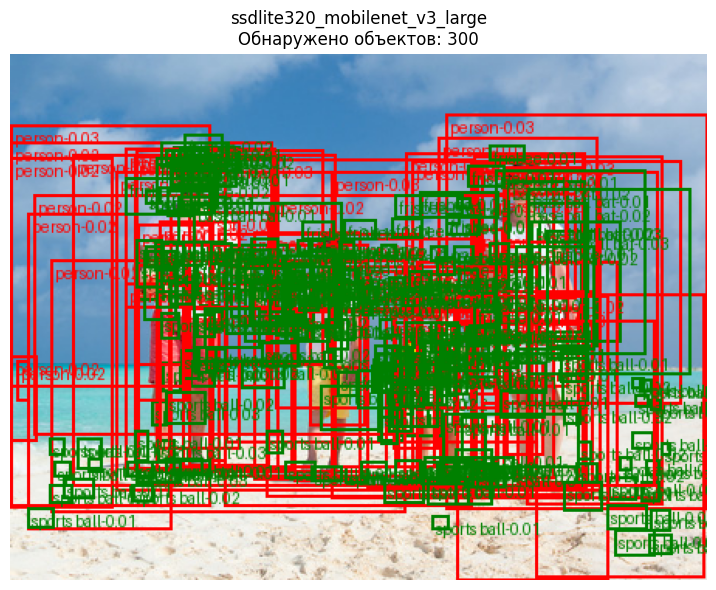

 2. ssd300_vgg16                        -> 200 объектов


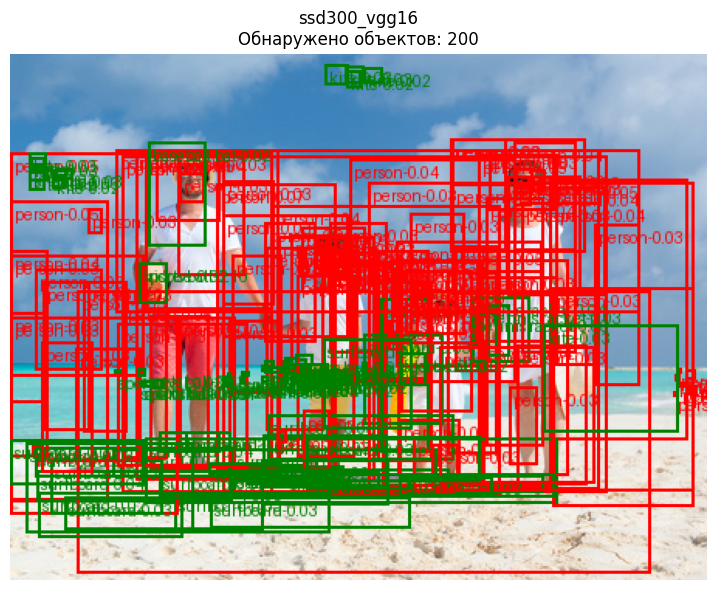

 3. retinanet_resnet50_fpn              -> 53 объектов


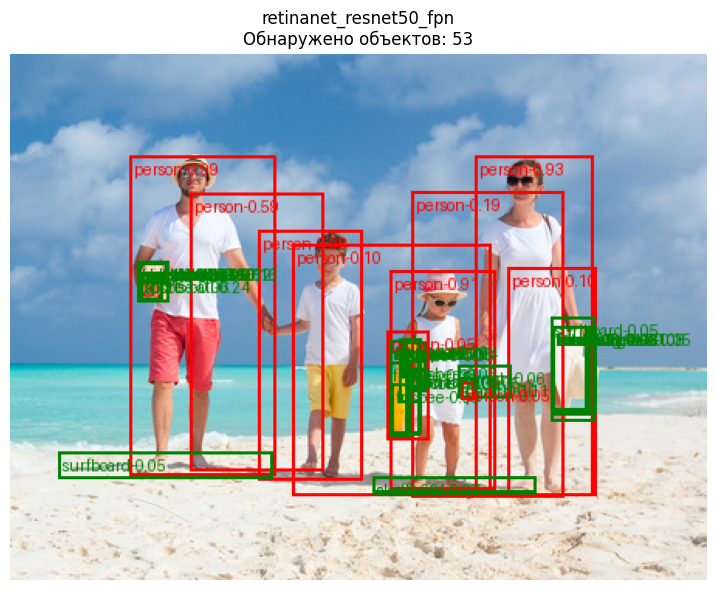

 4. fcos_resnet50_fpn                   -> 29 объектов


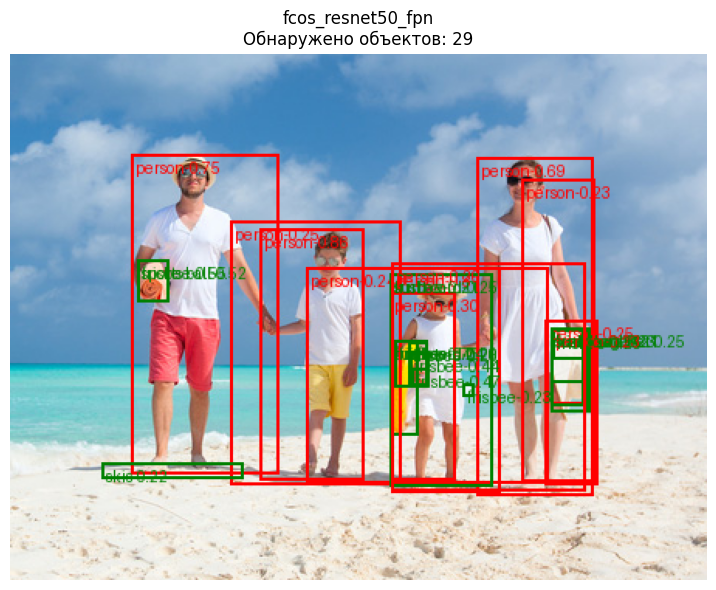

 5. fasterrcnn_mobilenet_v3_large_320_fpn -> 15 объектов


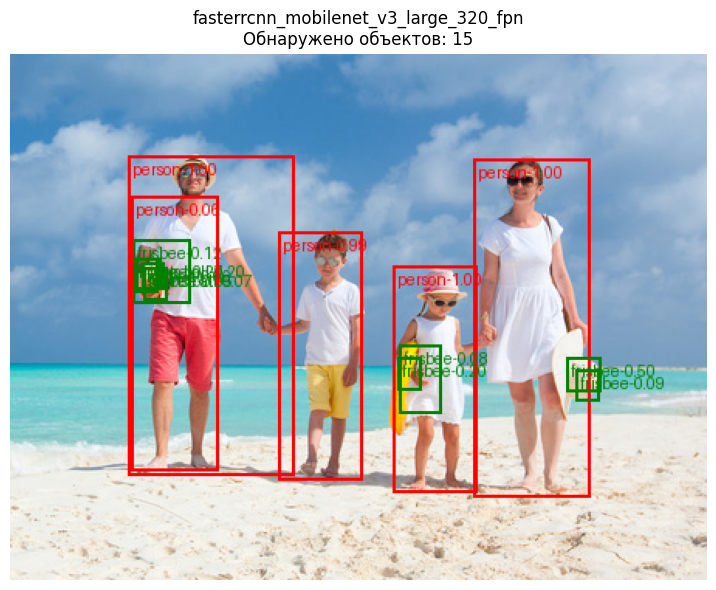


🏆 ТОП-5 МОДЕЛЕЙ ДЕТЕКЦИИ ДЛЯ kids_playing.jpg:
 1. ssdlite320_mobilenet_v3_large       -> 300 объектов


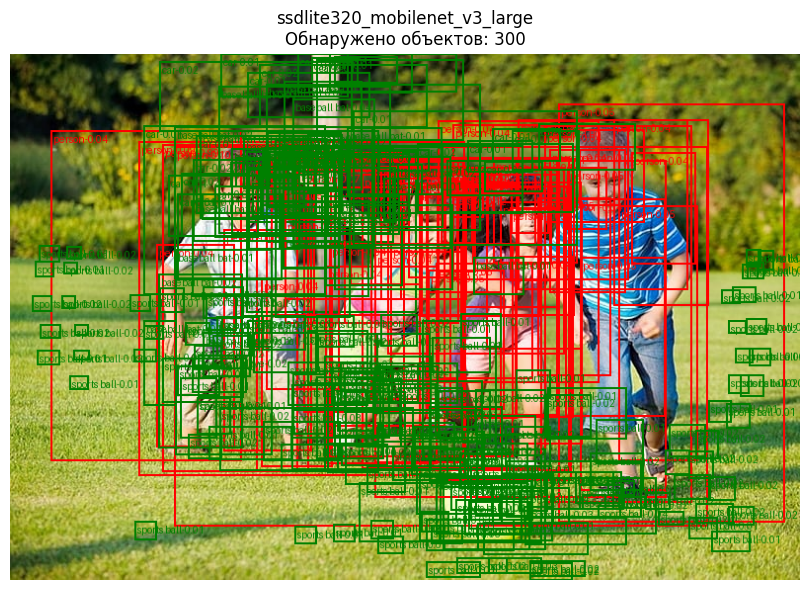

 2. ssd300_vgg16                        -> 200 объектов


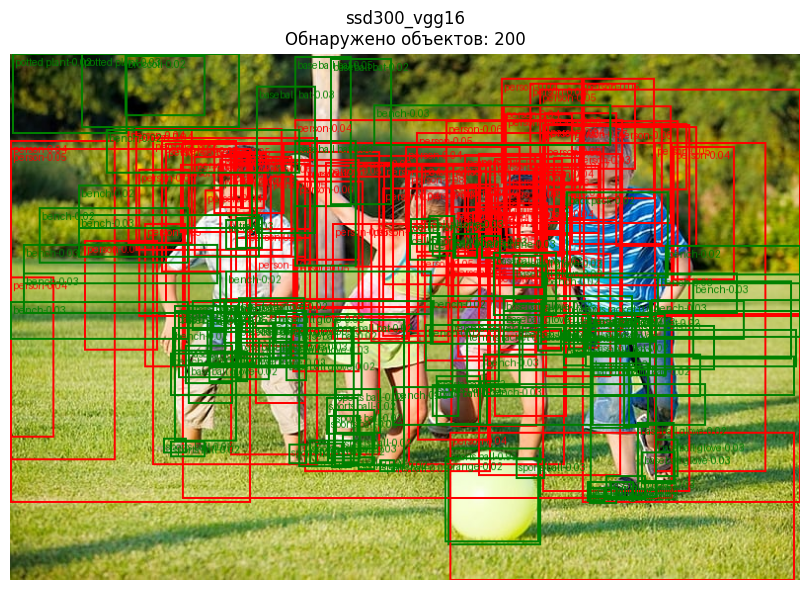

 3. retinanet_resnet50_fpn              -> 50 объектов


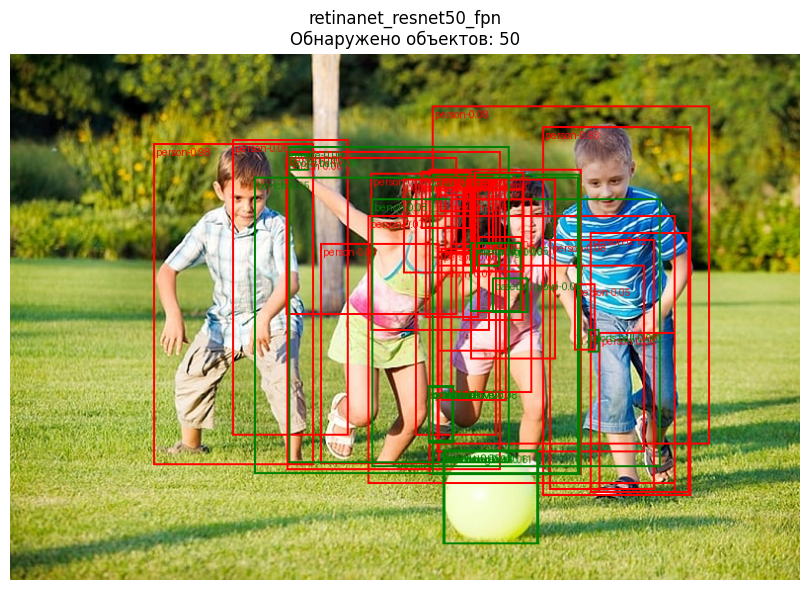

 4. fcos_resnet50_fpn                   -> 14 объектов


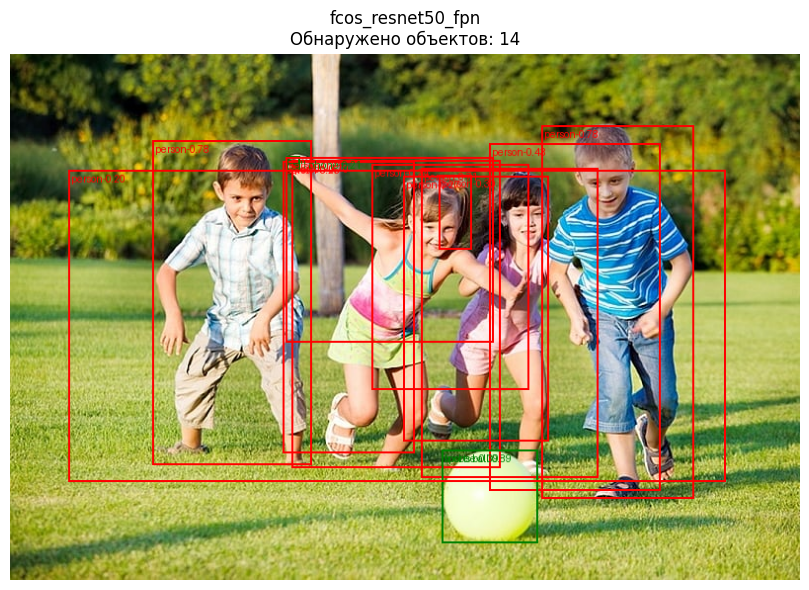

 5. maskrcnn_resnet50_fpn               -> 14 объектов


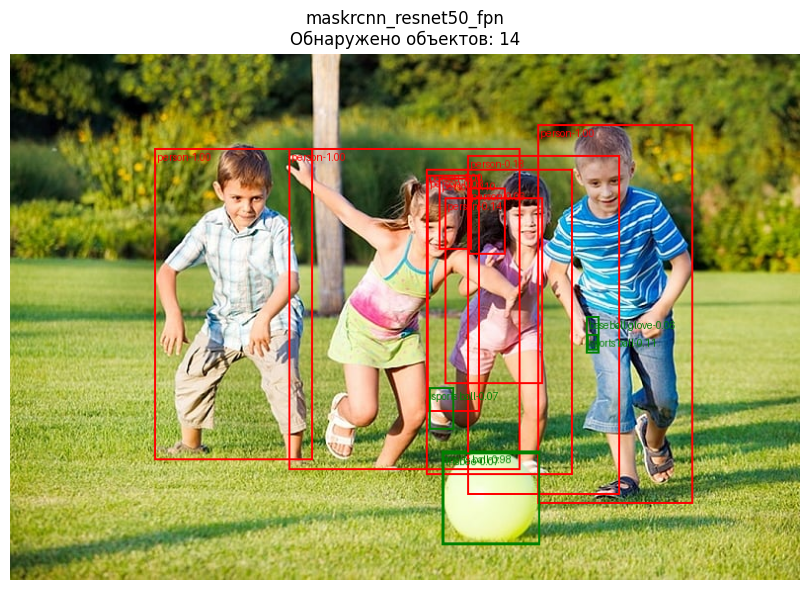

In [26]:
import matplotlib.pyplot as plt

def visualize_best_detection_models(results, image_tensor, image_name, coco, top_n=5):
    """Визуализация лучших моделей детекции"""
    detection_models = results['detection_models']
    successful_models = [m for m in detection_models if m[1] > 0]

    if not successful_models:
        print(f"Нет успешных моделей детекции для {image_name}")
        return

    # Сортируем по количеству обнаруженных объектов
    top_models = sorted(successful_models, key=lambda x: x[1], reverse=True)[:top_n]

    print(f"\n🏆 ТОП-{len(top_models)} МОДЕЛЕЙ ДЕТЕКЦИИ ДЛЯ {image_name}:")

    for i, (model_name, num_objects, predictions) in enumerate(top_models, 1):
        print(f"{i:2d}. {model_name:35} -> {num_objects:2d} объектов")

        try:
            # Визуализируем предсказания
            labels = coco.loadCats(predictions[0]["labels"].numpy())
            annot_labels = ["{}-{:.2f}".format(label["name"], prob) for label, prob in
                           zip(labels, predictions[0]["scores"].detach().numpy())]

            output = draw_bounding_boxes(
                image=image_tensor[0],
                boxes=predictions[0]["boxes"],
                labels=annot_labels,
                colors=["red" if label["name"]=="person" else "green" for label in labels],
                width=2
            )

            pil_image = to_pil_image(output)

            plt.figure(figsize=(12, 6))
            plt.imshow(pil_image)
            plt.title(f"{model_name}\nОбнаружено объектов: {num_objects}")
            plt.axis('off')
            plt.tight_layout()
            plt.show()

        except Exception as e:
            print(f"   Ошибка визуализации: {e}")

# Визуализируем лучшие модели
print("\n" + "="*70)
print("ВИЗУАЛИЗАЦИЯ ЛУЧШИХ МОДЕЛЕЙ ДЕТЕКЦИИ")
print("="*70)

visualize_best_detection_models(holiday_comprehensive, holiday_tensor_int, "holiday.jpg", coco, 5)
visualize_best_detection_models(kids_comprehensive, kids_playing_tensor_int, "kids_playing.jpg", coco, 5)

## **Testing left PyTorch detection models**

In [30]:
holiday_preds_1 = object_detection_model_1(holiday_tensor_float)
holiday_preds_1

[{'boxes': tensor([[ 76.6817,  66.5603, 183.3120, 272.0569],
          [299.5677,  68.9363, 374.7339, 286.6753],
          [247.0694, 137.1988, 301.5916, 283.7570],
          [173.0177, 115.3674, 227.1968, 275.2950],
          [359.7599, 196.7041, 381.6214, 218.5448],
          [ 80.4225, 132.4947,  95.5244, 154.7982],
          [250.1845, 196.5582, 265.9760, 217.4535],
          [ 81.9488, 132.2424,  97.6845, 152.9736],
          [ 79.4684, 120.8164, 116.0978, 161.6820],
          [365.1971, 204.7336, 380.3201, 224.8235],
          [251.1116, 188.2479, 278.5035, 232.6805],
          [ 86.3030, 138.3908, 101.8408, 159.4239],
          [ 85.9698, 135.1701,  99.0991, 152.4689],
          [ 78.7673,  92.9299, 134.1843, 269.5384],
          [ 86.0817, 138.3913, 101.7774, 159.6894]], grad_fn=<StackBackward0>),
  'labels': tensor([ 1,  1,  1,  1, 34, 34, 34, 37, 34, 34, 34, 37, 34,  1, 34]),
  'scores': tensor([0.9992, 0.9989, 0.9977, 0.9950, 0.4995, 0.2704, 0.2019, 0.2004, 0.1223,
         

In [31]:
holiday_preds_2 = object_detection_model_2(holiday_tensor_float)
holiday_preds_2

[{'boxes': tensor([[ 78.5918,  66.4777, 175.4152, 272.1148],
          [297.9290,  66.4648, 369.2754, 283.6527],
          [246.1990, 137.2946, 313.3107, 285.6231],
          [159.3506, 117.1702, 229.3888, 272.3508],
          [245.7812, 186.2931, 263.4301, 247.0817],
          [ 83.6667, 139.8591, 100.1302, 160.4951],
          [349.9905, 179.7363, 381.3567, 226.3120],
          [347.8987, 178.8589, 380.9431, 228.7209],
          [349.2538, 176.0731, 381.1476, 228.0504],
          [ 83.2235, 139.4136, 100.6955, 161.1721],
          [ 84.5333, 142.9360,  93.2222, 158.9622],
          [244.4558, 182.2403, 264.4744, 249.0328],
          [351.4710, 183.3524, 381.3659, 227.2810]], grad_fn=<StackBackward0>),
  'labels': tensor([ 1,  1,  1,  1, 34, 37, 34, 42, 31, 34, 37, 42, 37]),
  'scores': tensor([0.9997, 0.9991, 0.9983, 0.9980, 0.8408, 0.6068, 0.5153, 0.2541, 0.2015,
          0.1649, 0.1119, 0.0881, 0.0548], grad_fn=<IndexBackward0>)}]

In [32]:
holiday_preds_3 = object_detection_model_3(holiday_tensor_float)
holiday_preds_3

[{'boxes': tensor([[161.0563, 113.8106, 228.1137, 275.2033],
          [246.0609, 138.0667, 316.1322, 283.3388],
          [245.1635, 185.1220, 263.6907, 246.4652],
          [ 78.8383,  65.5172, 173.7999, 271.7146],
          [301.5287,  67.3656, 376.7123, 285.1455],
          [ 82.9575, 133.7801, 102.7592, 160.7542],
          [ 82.8930, 133.9362, 102.9713, 160.6927],
          [259.5405, 203.0811, 270.4624, 214.9131],
          [258.8858, 193.0149, 270.6595, 214.9406],
          [349.4142, 177.4539, 373.3396, 231.7559],
          [245.4232, 154.3627, 287.5204, 275.3274],
          [245.1635, 185.1220, 263.6907, 246.4652],
          [257.1257, 186.1949, 269.5074, 215.7112],
          [142.4145, 108.5469, 252.3088, 278.5098],
          [245.3122, 142.6300, 311.1230, 279.9651],
          [350.6176, 178.0560, 370.2780, 197.7211],
          [349.4142, 177.4539, 373.3396, 231.7559],
          [345.8838, 172.1706, 379.0482, 278.0352],
          [349.7548, 177.9693, 370.2749, 212.0249],
   

In [33]:
holiday_preds_4 = object_detection_model_4(holiday_tensor_float)
holiday_preds_4

[{'boxes': tensor([[299.7061,  66.3618, 370.2451, 285.0236],
          [ 80.3544,  66.6788, 173.6853, 269.4829],
          [248.1687, 141.0489, 305.2798, 285.6744],
          ...,
          [295.2153,  72.8450, 319.9444,  86.1293],
          [200.2016, 214.5862, 239.5680, 243.5365],
          [322.8772, 199.6246, 346.8771, 219.8029]], grad_fn=<StackBackward0>),
  'scores': tensor([0.9962, 0.9865, 0.9837, 0.8407, 0.1025, 0.0529, 0.0510, 0.0477, 0.0456,
          0.0428, 0.0427, 0.0401, 0.0384, 0.0361, 0.0339, 0.0332, 0.0318, 0.0316,
          0.0310, 0.0305, 0.0300, 0.0295, 0.0293, 0.0292, 0.0291, 0.0281, 0.0279,
          0.0279, 0.0277, 0.0276, 0.0273, 0.0270, 0.0269, 0.0262, 0.0261, 0.0257,
          0.0256, 0.0255, 0.0255, 0.0252, 0.0247, 0.0232, 0.0231, 0.0231, 0.0226,
          0.0226, 0.0226, 0.0221, 0.0219, 0.0218, 0.0217, 0.0216, 0.0216, 0.0216,
          0.0215, 0.0214, 0.0213, 0.0212, 0.0212, 0.0211, 0.0209, 0.0208, 0.0208,
          0.0206, 0.0206, 0.0203, 0.0203, 0.0203, 0.

In [34]:
holiday_preds_5 = object_detection_model_5(holiday_tensor_float)
holiday_preds_5

[{'boxes': tensor([[ 81.2480,  62.5080, 173.0967, 275.4309],
          [173.8207, 118.2018, 235.9650, 276.0524],
          [240.3249, 134.6581, 305.2447, 279.3232],
          [302.1714,  62.3841, 380.8842, 281.3284],
          [ 83.4111, 135.0316, 101.5817, 161.2563],
          [133.6136,  84.9568, 210.7917, 269.9261],
          [282.1780, 141.1435, 314.4301, 258.6894],
          [144.5882, 268.7751, 283.6488, 285.0991],
          [ 72.1402,  66.0925, 385.9062, 283.4297],
          [237.9220, 147.5735, 272.3398, 263.2990],
          [165.6761, 125.8826, 202.8468, 243.9141],
          [302.7853,  65.4099, 353.4081, 145.2456],
          [178.7724, 202.5053, 183.7415, 206.1837],
          [287.7371, 124.2300, 315.8492, 205.4546],
          [185.6202, 202.4253, 191.4668, 207.6408],
          [144.1091, 255.6117, 275.9389, 276.6083],
          [239.0478, 158.8309, 270.8975, 257.4335],
          [ 90.8653, 169.3149, 128.3070, 268.4405],
          [  0.0000,  64.8806, 138.2082, 289.6160],
   

In [35]:
holiday_preds_6 = object_detection_model_6(holiday_tensor_float)
holiday_preds_6

[{'boxes': tensor([[ 77.7199,  66.1016, 171.3946, 272.1963],
          [160.1267, 114.3422, 227.4356, 275.4149],
          [300.7717,  66.8351, 376.1077, 285.9815],
          [245.5599, 140.2268, 313.3727, 281.6314],
          [116.7345,  90.3466, 202.0466, 269.5193],
          [245.9203, 185.6431, 264.6906, 245.9544],
          [ 82.6066, 134.3677, 102.6736, 160.2644],
          [ 82.5953, 134.4728, 102.5872, 160.4991],
          [259.1920, 204.3367, 270.1988, 215.4897],
          [244.9414, 199.3759, 258.7860, 247.6674],
          [ 84.0987, 142.9976,  98.5684, 159.6428],
          [245.9203, 185.6431, 264.6906, 245.9544],
          [259.8885,  89.6121, 357.5665, 286.1522],
          [ 82.7160, 134.7164, 102.4250, 160.0707],
          [245.5312, 185.4067, 265.0625, 245.5879],
          [245.9203, 185.6431, 264.6906, 245.9544],
          [ 82.7444, 134.8779, 102.4247, 160.0063],
          [ 82.6518, 134.4245, 102.7007, 160.5603],
          [291.3647, 209.6290, 300.0863, 222.0972],
   

In [36]:
holiday_preds_7 = object_detection_model_7(holiday_tensor_float)
holiday_preds_7

[{'boxes': tensor([[ 77.9773,  64.7163, 177.5218, 272.5209],
          [160.6640, 115.1650, 227.0088, 275.5655],
          [298.0365,  66.8733, 377.6007, 285.1699],
          [248.2706, 138.9455, 313.2417, 283.5196],
          [ 82.4802, 134.6662, 102.9353, 160.9531],
          [244.6596, 182.8792, 264.0410, 246.9740],
          [349.7864, 178.5314, 376.2023, 226.4506],
          [ 82.7774, 134.8471, 102.7454, 159.9317],
          [244.7601, 184.6790, 264.0072, 244.9849],
          [ 83.9920, 143.3910,  99.0913, 159.6041],
          [259.8443, 203.2216, 270.5441, 214.9231],
          [244.4316, 182.7719, 292.0699, 243.5287],
          [350.1138, 177.0857, 380.1573, 227.1825]], grad_fn=<StackBackward0>),
  'labels': tensor([ 1,  1,  1,  1, 37, 34, 34, 34, 42, 37, 34, 42, 31]),
  'scores': tensor([0.9999, 0.9997, 0.9997, 0.9995, 0.9216, 0.7650, 0.5774, 0.5474, 0.4417,
          0.3151, 0.2165, 0.1617, 0.0852], grad_fn=<IndexBackward0>),
  'masks': tensor([[[[0., 0., 0.,  ..., 0., 0., 0.]

In [37]:
holiday_preds_8 = object_detection_model_8(holiday_tensor_float)
holiday_preds_8

[{'boxes': tensor([[ 80.8509,  65.5636, 171.5578, 273.3744],
          [248.6908, 139.3719, 311.0390, 283.0828],
          [159.2170, 117.7948, 228.2243, 275.0737],
          [299.7191,  66.4954, 374.7089, 286.5757]], grad_fn=<StackBackward0>),
  'labels': tensor([1, 1, 1, 1]),
  'scores': tensor([0.9999, 0.9997, 0.9997, 0.9997], grad_fn=<IndexBackward0>),
  'keypoints': tensor([[[118.3629,  79.8001,   1.0000],
           [122.6015,  76.8253,   1.0000],
           [114.5481,  76.8253,   1.0000],
           [127.6879,  83.6248,   1.0000],
           [108.6140,  81.9249,   1.0000],
           [136.1652, 108.6981,   1.0000],
           [ 98.0174, 107.4232,   1.0000],
           [147.6095, 136.7462,   1.0000],
           [ 85.3015, 135.4713,   1.0000],
           [162.4448, 164.7943,   1.0000],
           [ 88.6924, 146.5205,   1.0000],
           [126.4163, 169.8939,   1.0000],
           [101.8322, 169.4690,   1.0000],
           [123.0254, 215.3658,   1.0000],
           [ 98.8651, 211.

In [1]:
print('End')

End


In [38]:
holiday_preds_1[0]["boxes"] = holiday_preds_1[0]["boxes"][holiday_preds_1[0]["scores"] > 0.8]
holiday_preds_1[0]["labels"] = holiday_preds_1[0]["labels"][holiday_preds_1[0]["scores"] > 0.8]
holiday_preds_1[0]["scores"] = holiday_preds_1[0]["scores"][holiday_preds_1[0]["scores"] > 0.8]

holiday_preds_1

[{'boxes': tensor([[ 76.6817,  66.5603, 183.3120, 272.0569],
          [299.5677,  68.9363, 374.7339, 286.6753],
          [247.0694, 137.1988, 301.5916, 283.7570],
          [173.0177, 115.3674, 227.1968, 275.2950]], grad_fn=<IndexBackward0>),
  'labels': tensor([1, 1, 1, 1]),
  'scores': tensor([0.9992, 0.9989, 0.9977, 0.9950], grad_fn=<IndexBackward0>)}]

In [39]:
holiday_preds_2[0]["boxes"] = holiday_preds_2[0]["boxes"][holiday_preds_2[0]["scores"] > 0.8]
holiday_preds_2[0]["labels"] = holiday_preds_2[0]["labels"][holiday_preds_2[0]["scores"] > 0.8]
holiday_preds_2[0]["scores"] = holiday_preds_2[0]["scores"][holiday_preds_2[0]["scores"] > 0.8]

holiday_preds_2

[{'boxes': tensor([[ 78.5918,  66.4777, 175.4152, 272.1148],
          [297.9290,  66.4648, 369.2754, 283.6527],
          [246.1990, 137.2946, 313.3107, 285.6231],
          [159.3506, 117.1702, 229.3888, 272.3508],
          [245.7812, 186.2931, 263.4301, 247.0817]], grad_fn=<IndexBackward0>),
  'labels': tensor([ 1,  1,  1,  1, 34]),
  'scores': tensor([0.9997, 0.9991, 0.9983, 0.9980, 0.8408], grad_fn=<IndexBackward0>)}]

In [40]:
holiday_preds_3[0]["boxes"] = holiday_preds_3[0]["boxes"][holiday_preds_3[0]["scores"] > 0.8]
holiday_preds_3[0]["labels"] = holiday_preds_3[0]["labels"][holiday_preds_3[0]["scores"] > 0.8]
holiday_preds_3[0]["scores"] = holiday_preds_3[0]["scores"][holiday_preds_3[0]["scores"] > 0.8]

holiday_preds_3

[{'boxes': tensor([[161.0563, 113.8106, 228.1137, 275.2033],
          [246.0609, 138.0667, 316.1322, 283.3388]], grad_fn=<IndexBackward0>),
  'scores': tensor([0.8621, 0.8108], grad_fn=<IndexBackward0>),
  'labels': tensor([1, 1])}]

In [41]:
holiday_preds_4[0]["boxes"] = holiday_preds_4[0]["boxes"][holiday_preds_4[0]["scores"] > 0.8]
holiday_preds_4[0]["labels"] = holiday_preds_4[0]["labels"][holiday_preds_4[0]["scores"] > 0.8]
holiday_preds_4[0]["scores"] = holiday_preds_4[0]["scores"][holiday_preds_4[0]["scores"] > 0.8]

holiday_preds_4

[{'boxes': tensor([[299.7061,  66.3618, 370.2451, 285.0236],
          [ 80.3544,  66.6788, 173.6853, 269.4829],
          [248.1687, 141.0489, 305.2798, 285.6744],
          [157.4859, 115.8955, 226.9771, 275.4838]], grad_fn=<IndexBackward0>),
  'scores': tensor([0.9962, 0.9865, 0.9837, 0.8407], grad_fn=<IndexBackward0>),
  'labels': tensor([1, 1, 1, 1])}]

In [42]:
holiday_preds_5[0]["boxes"] = holiday_preds_5[0]["boxes"][holiday_preds_5[0]["scores"] > 0.8]
holiday_preds_5[0]["labels"] = holiday_preds_5[0]["labels"][holiday_preds_5[0]["scores"] > 0.8]
holiday_preds_5[0]["scores"] = holiday_preds_5[0]["scores"][holiday_preds_5[0]["scores"] > 0.8]

holiday_preds_5

[{'boxes': tensor([[ 81.2480,  62.5080, 173.0967, 275.4309]], grad_fn=<IndexBackward0>),
  'scores': tensor([1.0000], grad_fn=<IndexBackward0>),
  'labels': tensor([1])}]

In [43]:
holiday_preds_6[0]["boxes"] = holiday_preds_6[0]["boxes"][holiday_preds_6[0]["scores"] > 0.8]
holiday_preds_6[0]["labels"] = holiday_preds_6[0]["labels"][holiday_preds_6[0]["scores"] > 0.8]
holiday_preds_6[0]["scores"] = holiday_preds_6[0]["scores"][holiday_preds_6[0]["scores"] > 0.8]

holiday_preds_6

[{'boxes': tensor([[ 77.7199,  66.1016, 171.3946, 272.1963],
          [160.1267, 114.3422, 227.4356, 275.4149],
          [300.7717,  66.8351, 376.1077, 285.9815],
          [245.5599, 140.2268, 313.3727, 281.6314]], grad_fn=<IndexBackward0>),
  'scores': tensor([0.9861, 0.9609, 0.9260, 0.9077], grad_fn=<IndexBackward0>),
  'labels': tensor([1, 1, 1, 1])}]

In [44]:
holiday_preds_7[0]["boxes"] = holiday_preds_7[0]["boxes"][holiday_preds_7[0]["scores"] > 0.8]
holiday_preds_7[0]["labels"] = holiday_preds_7[0]["labels"][holiday_preds_7[0]["scores"] > 0.8]
holiday_preds_7[0]["scores"] = holiday_preds_7[0]["scores"][holiday_preds_7[0]["scores"] > 0.8]

holiday_preds_7

[{'boxes': tensor([[ 77.9773,  64.7163, 177.5218, 272.5209],
          [160.6640, 115.1650, 227.0088, 275.5655],
          [298.0365,  66.8733, 377.6007, 285.1699],
          [248.2706, 138.9455, 313.2417, 283.5196],
          [ 82.4802, 134.6662, 102.9353, 160.9531]], grad_fn=<IndexBackward0>),
  'labels': tensor([ 1,  1,  1,  1, 37]),
  'scores': tensor([0.9999, 0.9997, 0.9997, 0.9995, 0.9216], grad_fn=<IndexBackward0>),
  'masks': tensor([[[[0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0., 0.],
            ...,
            [0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0., 0.]]],
  
  
          [[[0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0., 0.],
            ...,
            [0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0.,

In [45]:
holiday_preds_8[0]["boxes"] = holiday_preds_8[0]["boxes"][holiday_preds_8[0]["scores"] > 0.8]
holiday_preds_8[0]["labels"] = holiday_preds_8[0]["labels"][holiday_preds_8[0]["scores"] > 0.8]
holiday_preds_8[0]["scores"] = holiday_preds_8[0]["scores"][holiday_preds_8[0]["scores"] > 0.8]

holiday_preds_8

[{'boxes': tensor([[ 80.8509,  65.5636, 171.5578, 273.3744],
          [248.6908, 139.3719, 311.0390, 283.0828],
          [159.2170, 117.7948, 228.2243, 275.0737],
          [299.7191,  66.4954, 374.7089, 286.5757]], grad_fn=<IndexBackward0>),
  'labels': tensor([1, 1, 1, 1]),
  'scores': tensor([0.9999, 0.9997, 0.9997, 0.9997], grad_fn=<IndexBackward0>),
  'keypoints': tensor([[[118.3629,  79.8001,   1.0000],
           [122.6015,  76.8253,   1.0000],
           [114.5481,  76.8253,   1.0000],
           [127.6879,  83.6248,   1.0000],
           [108.6140,  81.9249,   1.0000],
           [136.1652, 108.6981,   1.0000],
           [ 98.0174, 107.4232,   1.0000],
           [147.6095, 136.7462,   1.0000],
           [ 85.3015, 135.4713,   1.0000],
           [162.4448, 164.7943,   1.0000],
           [ 88.6924, 146.5205,   1.0000],
           [126.4163, 169.8939,   1.0000],
           [101.8322, 169.4690,   1.0000],
           [123.0254, 215.3658,   1.0000],
           [ 98.8651, 211.

In [46]:
kids_preds_1 = object_detection_model_1(kids_playing_tensor_float)

kids_preds_1

[{'boxes': tensor([[541.8506,  68.4801, 690.0012, 447.5684],
          [147.0456,  95.1531, 306.8673, 418.6879],
          [282.3428, 100.0587, 473.0233, 422.0708],
          [420.3326, 113.3274, 568.1756, 443.4251],
          [436.3722, 406.6468, 533.2471, 495.4895],
          [458.3900, 106.8620, 656.5619, 447.8973],
          [441.8137, 407.1424, 533.3552, 490.6398],
          [294.5195,  99.9320, 318.2791, 123.5662],
          [292.0042,  99.2188, 312.5306, 115.9018],
          [284.0497,  91.5591, 305.9523, 116.0521]], grad_fn=<StackBackward0>),
  'labels': tensor([ 1,  1,  1,  1, 37,  1, 34, 37, 37, 37]),
  'scores': tensor([0.9993, 0.9991, 0.9975, 0.9913, 0.8913, 0.4661, 0.1707, 0.1668, 0.1433,
          0.0617], grad_fn=<IndexBackward0>)}]

In [47]:
kids_preds_2 = object_detection_model_2(kids_playing_tensor_float)

kids_preds_2

[{'boxes': tensor([[543.9278,  74.7422, 691.6286, 455.1064],
          [148.9655,  92.2441, 301.8530, 417.2530],
          [287.6923, 108.1880, 503.5464, 419.4206],
          [424.4225, 118.9472, 574.9016, 429.8202],
          [438.2967, 404.2248, 535.7460, 493.8219],
          [437.2293, 402.5900, 535.5033, 494.7332],
          [480.4862,  97.2712, 654.9161, 446.6960],
          [278.4940, 104.3467, 305.1274, 125.8349],
          [279.6930, 105.3396, 304.0993, 125.0906],
          [281.6313, 104.8353, 298.3132, 119.5596]], grad_fn=<StackBackward0>),
  'labels': tensor([ 1,  1,  1,  1, 34, 37,  1, 34, 37, 34]),
  'scores': tensor([0.9997, 0.9995, 0.9975, 0.9949, 0.8080, 0.3434, 0.3344, 0.1822, 0.0651,
          0.0612], grad_fn=<IndexBackward0>)}]

In [48]:
kids_preds_3 = object_detection_model_3(kids_playing_tensor_float)

kids_preds_3

[{'boxes': tensor([[437.8256, 401.7179, 534.5775, 495.2248],
          [538.8081,  73.4855, 692.8972, 450.6479],
          [144.2392,  88.7450, 305.7083, 416.3978],
          [416.2243, 116.9890, 595.7776, 429.4374],
          [285.9019, 108.7825, 496.0548, 419.2025],
          [485.9802,  91.1862, 658.5819, 442.5486],
          [437.9951, 401.9168, 534.2367, 495.3720],
          [434.3167, 123.5876, 467.7444, 198.8377],
          [398.8164, 124.3788, 545.8040, 392.6490],
          [276.1215, 109.9230, 409.0572, 404.7579],
          [366.6573, 112.2687, 525.6074, 340.0645],
          [280.7534, 104.1988, 293.6419, 118.8770],
          [279.1478, 105.2800, 489.5842, 292.8503],
          [ 59.8460, 118.5557, 724.8073, 433.6410]], grad_fn=<StackBackward0>),
  'scores': tensor([0.8911, 0.7842, 0.7828, 0.7115, 0.7026, 0.4296, 0.3897, 0.3029, 0.2748,
          0.2495, 0.2358, 0.2089, 0.2076, 0.2043], grad_fn=<IndexBackward0>),
  'labels': tensor([37,  1,  1,  1,  1,  1, 34,  1,  1,  1,  1, 7

In [49]:
kids_preds_4 = object_detection_model_4(kids_playing_tensor_float)

kids_preds_4

[{'boxes': tensor([[541.9829,  73.2503, 690.8265, 454.6201],
          [154.6494,  92.3334, 302.6865, 423.4426],
          [290.6041, 109.2016, 459.2154, 422.6410],
          ...,
          [169.1126, 142.3007, 275.6759, 229.4990],
          [293.6484, 100.8650, 340.6970, 120.8828],
          [160.6000, 123.2858, 290.0935, 185.6213]], grad_fn=<StackBackward0>),
  'scores': tensor([0.9960, 0.9866, 0.9862, 0.9647, 0.4665, 0.3828, 0.2455, 0.1510, 0.1219,
          0.1216, 0.1019, 0.1003, 0.0978, 0.0933, 0.0746, 0.0705, 0.0676, 0.0671,
          0.0640, 0.0620, 0.0602, 0.0595, 0.0572, 0.0563, 0.0562, 0.0554, 0.0550,
          0.0543, 0.0540, 0.0523, 0.0517, 0.0517, 0.0506, 0.0504, 0.0501, 0.0496,
          0.0489, 0.0482, 0.0475, 0.0473, 0.0471, 0.0459, 0.0459, 0.0457, 0.0456,
          0.0456, 0.0456, 0.0455, 0.0436, 0.0434, 0.0432, 0.0431, 0.0431, 0.0427,
          0.0425, 0.0421, 0.0420, 0.0417, 0.0413, 0.0410, 0.0409, 0.0409, 0.0407,
          0.0405, 0.0403, 0.0401, 0.0401, 0.0399, 0.

In [50]:
kids_preds_5 = object_detection_model_5(kids_playing_tensor_float)

kids_preds_5

[{'boxes': tensor([[1.4484e+02, 8.5826e+01, 3.1131e+02, 4.1649e+02],
          [2.9885e+02, 1.1327e+02, 4.8644e+02, 4.2358e+02],
          [5.3966e+02, 7.2277e+01, 6.8881e+02, 4.4331e+02],
          [4.4372e+02, 3.9994e+02, 5.3712e+02, 4.9738e+02],
          [4.0309e+02, 1.1958e+02, 5.6189e+02, 4.1664e+02],
          [4.7461e+02, 1.0190e+02, 6.1817e+02, 4.2782e+02],
          [4.9090e+02, 1.0653e+02, 5.5945e+02, 2.2833e+02],
          [2.2375e+02, 9.9329e+01, 3.7492e+02, 4.0602e+02],
          [4.4878e+02, 1.1103e+02, 5.8106e+02, 2.5196e+02],
          [5.4100e+02, 9.1667e+01, 6.0168e+02, 2.2585e+02],
          [4.9542e+02, 1.5589e+02, 5.6754e+02, 3.0099e+02],
          [5.6835e+02, 7.3423e+01, 6.6078e+02, 1.9307e+02],
          [3.0325e+02, 1.1370e+02, 4.7603e+02, 2.5721e+02],
          [1.7437e+02, 9.0076e+01, 6.7066e+02, 4.5063e+02],
          [5.4234e+02, 2.0202e+02, 6.0810e+02, 3.2800e+02],
          [4.1684e+02, 1.1161e+02, 4.8229e+02, 2.2586e+02],
          [5.4128e+02, 1.3299e+

In [51]:
kids_preds_6 = object_detection_model_6(kids_playing_tensor_float)

kids_preds_6

[{'boxes': tensor([[145.4986,  91.7559, 307.7704, 416.5255],
          [438.4327, 402.2989, 534.8918, 496.5975],
          [539.0557,  74.7825, 689.4353, 447.3208],
          [280.2833,  99.1782, 496.3865, 421.2509],
          [424.6714, 117.8458, 578.0765, 426.0738],
          [439.6354, 401.9212, 535.0588, 496.5855],
          [434.5541, 122.9940, 463.6354, 144.1606],
          [432.7223, 122.4631, 468.9798, 201.1187],
          [438.8190, 402.3989, 534.2283, 496.3185],
          [410.0375, 127.5798, 492.7805, 386.1221],
          [435.2294, 123.4133, 467.3002, 160.3582],
          [420.1934, 128.0782, 474.0574, 267.3611],
          [587.9510, 181.5385, 687.4215, 444.4847],
          [423.4100, 337.9335, 448.7371, 394.0250],
          [438.2480, 402.5730, 534.7397, 496.2294],
          [398.0767, 127.2711, 469.5123, 222.5241],
          [432.2883, 126.5342, 501.2843, 301.8100],
          [460.1479, 127.6491, 501.6482, 214.4591],
          [314.4101, 192.9933, 434.8766, 415.0408],
   

In [52]:
kids_preds_7 = object_detection_model_7(kids_playing_tensor_float)

kids_preds_7

[{'boxes': tensor([[534.4597,  72.0635, 691.8905, 455.9582],
          [146.1185,  96.2099, 306.3862, 411.5848],
          [282.6569,  96.3513, 516.8189, 421.7361],
          [421.0261, 117.7528, 569.9863, 426.6977],
          [437.5678, 402.6298, 536.1226, 497.7726],
          [440.9341, 146.8359, 539.3091, 334.6515],
          [463.6707, 103.9118, 617.3519, 446.2708],
          [584.8990, 284.9525, 595.4290, 300.9348],
          [434.5564, 126.0020, 467.8062, 198.3042],
          [422.7612, 123.6024, 475.0480, 362.0228],
          [438.1426, 404.2519, 536.8579, 496.4565],
          [424.3539, 338.8196, 449.8463, 380.4694],
          [583.4283, 266.2067, 596.2690, 303.6043],
          [464.6900, 136.4001, 501.1157, 203.8759]], grad_fn=<StackBackward0>),
  'labels': tensor([ 1,  1,  1,  1, 37,  1,  1, 37,  1,  1, 34, 37, 40,  1]),
  'scores': tensor([0.9996, 0.9996, 0.9972, 0.9970, 0.9756, 0.1412, 0.1315, 0.1088, 0.0954,
          0.0791, 0.0670, 0.0654, 0.0645, 0.0624], grad_fn=<Index

In [53]:
kids_preds_8 = object_detection_model_8(kids_playing_tensor_float)

kids_preds_8

[{'boxes': tensor([[541.3766,  72.4956, 694.1841, 453.4958],
          [147.6362,  93.8401, 307.8175, 413.7621],
          [287.4773, 103.0464, 504.0548, 420.5357],
          [420.7005, 121.0809, 580.3568, 422.0372],
          [432.8923, 175.4412, 534.2084, 398.0043],
          [395.5995,  93.3887, 682.4680, 431.6013]], grad_fn=<StackBackward0>),
  'labels': tensor([1, 1, 1, 1, 1, 1]),
  'scores': tensor([0.9999, 0.9998, 0.9996, 0.9983, 0.0759, 0.0527],
         grad_fn=<IndexBackward0>),
  'keypoints': tensor([[[604.1605, 140.1031,   1.0000],
           [613.4619, 128.7797,   1.0000],
           [593.5305, 132.1101,   1.0000],
           [628.7426, 120.1206,   1.0000],
           [576.9210, 126.1153,   1.0000],
           [647.3453, 155.4231,   1.0000],
           [568.2840, 174.0734,   1.0000],
           [681.2287, 212.7063,   1.0000],
           [553.0033, 222.6976,   1.0000],
           [657.9753, 261.9965,   1.0000],
           [574.2634, 265.9930,   1.0000],
           [651.3315

In [54]:
kids_preds_1[0]["boxes"] = kids_preds_1[0]["boxes"][kids_preds_1[0]["scores"] > 0.8]
kids_preds_1[0]["labels"] = kids_preds_1[0]["labels"][kids_preds_1[0]["scores"] > 0.8]
kids_preds_1[0]["scores"] = kids_preds_1[0]["scores"][kids_preds_1[0]["scores"] > 0.8]

kids_preds_1

[{'boxes': tensor([[541.8506,  68.4801, 690.0012, 447.5684],
          [147.0456,  95.1531, 306.8673, 418.6879],
          [282.3428, 100.0587, 473.0233, 422.0708],
          [420.3326, 113.3274, 568.1756, 443.4251],
          [436.3722, 406.6468, 533.2471, 495.4895]], grad_fn=<IndexBackward0>),
  'labels': tensor([ 1,  1,  1,  1, 37]),
  'scores': tensor([0.9993, 0.9991, 0.9975, 0.9913, 0.8913], grad_fn=<IndexBackward0>)}]

In [55]:
kids_preds_2[0]["boxes"] = kids_preds_2[0]["boxes"][kids_preds_2[0]["scores"] > 0.8]
kids_preds_2[0]["labels"] = kids_preds_2[0]["labels"][kids_preds_2[0]["scores"] > 0.8]
kids_preds_2[0]["scores"] = kids_preds_2[0]["scores"][kids_preds_2[0]["scores"] > 0.8]

kids_preds_2

[{'boxes': tensor([[543.9278,  74.7422, 691.6286, 455.1064],
          [148.9655,  92.2441, 301.8530, 417.2530],
          [287.6923, 108.1880, 503.5464, 419.4206],
          [424.4225, 118.9472, 574.9016, 429.8202],
          [438.2967, 404.2248, 535.7460, 493.8219]], grad_fn=<IndexBackward0>),
  'labels': tensor([ 1,  1,  1,  1, 34]),
  'scores': tensor([0.9997, 0.9995, 0.9975, 0.9949, 0.8080], grad_fn=<IndexBackward0>)}]

In [56]:
kids_preds_3[0]["boxes"] = kids_preds_3[0]["boxes"][kids_preds_3[0]["scores"] > 0.8]
kids_preds_3[0]["labels"] = kids_preds_3[0]["labels"][kids_preds_3[0]["scores"] > 0.8]
kids_preds_3[0]["scores"] = kids_preds_3[0]["scores"][kids_preds_3[0]["scores"] > 0.8]

kids_preds_3

[{'boxes': tensor([[437.8256, 401.7179, 534.5775, 495.2248]], grad_fn=<IndexBackward0>),
  'scores': tensor([0.8911], grad_fn=<IndexBackward0>),
  'labels': tensor([37])}]

In [57]:
kids_preds_4[0]["boxes"] = kids_preds_4[0]["boxes"][kids_preds_4[0]["scores"] > 0.8]
kids_preds_4[0]["labels"] = kids_preds_4[0]["labels"][kids_preds_4[0]["scores"] > 0.8]
kids_preds_4[0]["scores"] = kids_preds_4[0]["scores"][kids_preds_4[0]["scores"] > 0.8]

kids_preds_4

[{'boxes': tensor([[541.9829,  73.2503, 690.8265, 454.6201],
          [154.6494,  92.3334, 302.6865, 423.4426],
          [290.6041, 109.2016, 459.2154, 422.6410],
          [414.5442, 134.9825, 568.8132, 432.7520]], grad_fn=<IndexBackward0>),
  'scores': tensor([0.9960, 0.9866, 0.9862, 0.9647], grad_fn=<IndexBackward0>),
  'labels': tensor([1, 1, 1, 1])}]

In [58]:
kids_preds_5[0]["boxes"] = kids_preds_5[0]["boxes"][kids_preds_5[0]["scores"] > 0.8]
kids_preds_5[0]["labels"] = kids_preds_5[0]["labels"][kids_preds_5[0]["scores"] > 0.8]
kids_preds_5[0]["scores"] = kids_preds_5[0]["scores"][kids_preds_5[0]["scores"] > 0.8]

kids_preds_5

[{'boxes': tensor([[144.8440,  85.8260, 311.3147, 416.4933],
          [298.8513, 113.2655, 486.4360, 423.5766],
          [539.6622,  72.2765, 688.8085, 443.3144],
          [443.7157, 399.9408, 537.1233, 497.3846],
          [403.0932, 119.5775, 561.8917, 416.6406]], grad_fn=<IndexBackward0>),
  'scores': tensor([1.0000, 0.9978, 0.9955, 0.9902, 0.9771], grad_fn=<IndexBackward0>),
  'labels': tensor([ 1,  1,  1, 37,  1])}]

In [59]:
kids_preds_6[0]["boxes"] = kids_preds_6[0]["boxes"][kids_preds_6[0]["scores"] > 0.8]
kids_preds_6[0]["labels"] = kids_preds_6[0]["labels"][kids_preds_6[0]["scores"] > 0.8]
kids_preds_6[0]["scores"] = kids_preds_6[0]["scores"][kids_preds_6[0]["scores"] > 0.8]

kids_preds_6

[{'boxes': tensor([[145.4986,  91.7559, 307.7704, 416.5255],
          [438.4327, 402.2989, 534.8918, 496.5975],
          [539.0557,  74.7825, 689.4353, 447.3208],
          [280.2833,  99.1782, 496.3865, 421.2509],
          [424.6714, 117.8458, 578.0765, 426.0738]], grad_fn=<IndexBackward0>),
  'scores': tensor([0.9771, 0.9387, 0.9329, 0.9029, 0.8218], grad_fn=<IndexBackward0>),
  'labels': tensor([ 1, 37,  1,  1,  1])}]

In [60]:
kids_preds_7[0]["boxes"] = kids_preds_7[0]["boxes"][kids_preds_7[0]["scores"] > 0.8]
kids_preds_7[0]["labels"] = kids_preds_7[0]["labels"][kids_preds_7[0]["scores"] > 0.8]
kids_preds_7[0]["scores"] = kids_preds_7[0]["scores"][kids_preds_7[0]["scores"] > 0.8]

kids_preds_7

[{'boxes': tensor([[534.4597,  72.0635, 691.8905, 455.9582],
          [146.1185,  96.2099, 306.3862, 411.5848],
          [282.6569,  96.3513, 516.8189, 421.7361],
          [421.0261, 117.7528, 569.9863, 426.6977],
          [437.5678, 402.6298, 536.1226, 497.7726]], grad_fn=<IndexBackward0>),
  'labels': tensor([ 1,  1,  1,  1, 37]),
  'scores': tensor([0.9996, 0.9996, 0.9972, 0.9970, 0.9756], grad_fn=<IndexBackward0>),
  'masks': tensor([[[[0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0., 0.],
            ...,
            [0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0., 0.]]],
  
  
          [[[0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0., 0.],
            ...,
            [0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0., 0.],
            [0., 0., 0.,  ..., 0., 0.,

In [61]:
kids_preds_8[0]["boxes"] = kids_preds_8[0]["boxes"][kids_preds_8[0]["scores"] > 0.8]
kids_preds_8[0]["labels"] = kids_preds_8[0]["labels"][kids_preds_8[0]["scores"] > 0.8]
kids_preds_8[0]["scores"] = kids_preds_8[0]["scores"][kids_preds_8[0]["scores"] > 0.8]

kids_preds_8

[{'boxes': tensor([[541.3766,  72.4956, 694.1841, 453.4958],
          [147.6362,  93.8401, 307.8175, 413.7621],
          [287.4773, 103.0464, 504.0548, 420.5357],
          [420.7005, 121.0809, 580.3568, 422.0372]], grad_fn=<IndexBackward0>),
  'labels': tensor([1, 1, 1, 1]),
  'scores': tensor([0.9999, 0.9998, 0.9996, 0.9983], grad_fn=<IndexBackward0>),
  'keypoints': tensor([[[604.1605, 140.1031,   1.0000],
           [613.4619, 128.7797,   1.0000],
           [593.5305, 132.1101,   1.0000],
           [628.7426, 120.1206,   1.0000],
           [576.9210, 126.1153,   1.0000],
           [647.3453, 155.4231,   1.0000],
           [568.2840, 174.0734,   1.0000],
           [681.2287, 212.7063,   1.0000],
           [553.0033, 222.6976,   1.0000],
           [657.9753, 261.9965,   1.0000],
           [574.2634, 265.9930,   1.0000],
           [651.3315, 262.6626,   1.0000],
           [599.5099, 267.9913,   1.0000],
           [663.9548, 351.9179,   1.0000],
           [611.4688, 344.

## **Testing models objects labeling**

In [62]:
holiday_labels_1 = coco.loadCats(holiday_preds_1[0]["labels"].numpy())

holiday_labels_1

[{'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'}]

In [63]:
holiday_labels_2 = coco.loadCats(holiday_preds_2[0]["labels"].numpy())

holiday_labels_2

[{'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'sports', 'id': 34, 'name': 'frisbee'}]

In [64]:
holiday_labels_3 = coco.loadCats(holiday_preds_3[0]["labels"].numpy())

holiday_labels_3

[{'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'}]

In [65]:
holiday_labels_4 = coco.loadCats(holiday_preds_4[0]["labels"].numpy())

holiday_labels_4

[{'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'}]

In [66]:
holiday_labels_5 = coco.loadCats(holiday_preds_5[0]["labels"].numpy())

holiday_labels_5

[{'supercategory': 'person', 'id': 1, 'name': 'person'}]

In [67]:
holiday_labels_6 = coco.loadCats(holiday_preds_6[0]["labels"].numpy())

holiday_labels_6

[{'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'}]

In [68]:
holiday_labels_7 = coco.loadCats(holiday_preds_7[0]["labels"].numpy())

holiday_labels_7

[{'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'sports', 'id': 37, 'name': 'sports ball'}]

In [70]:
holiday_labels_8 = coco.loadCats(holiday_preds_8[0]["labels"].numpy())

holiday_labels_8

[{'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'}]

In [71]:
kids_labels_1 = coco.loadCats(kids_preds_1[0]["labels"].numpy())

kids_labels_1

[{'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'sports', 'id': 37, 'name': 'sports ball'}]

In [72]:
kids_labels_2 = coco.loadCats(kids_preds_2[0]["labels"].numpy())

kids_labels_2

[{'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'sports', 'id': 34, 'name': 'frisbee'}]

In [73]:
kids_labels_3 = coco.loadCats(kids_preds_3[0]["labels"].numpy())

kids_labels_3

[{'supercategory': 'sports', 'id': 37, 'name': 'sports ball'}]

In [74]:
kids_labels_4 = coco.loadCats(kids_preds_4[0]["labels"].numpy())

kids_labels_4

[{'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'}]

In [75]:
kids_labels_5 = coco.loadCats(kids_preds_5[0]["labels"].numpy())

kids_labels_5

[{'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'sports', 'id': 37, 'name': 'sports ball'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'}]

In [76]:
kids_labels_6 = coco.loadCats(kids_preds_6[0]["labels"].numpy())

kids_labels_6

[{'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'sports', 'id': 37, 'name': 'sports ball'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'}]

In [95]:
kids_labels_7 = coco.loadCats(kids_preds_7[0]["labels"].numpy())

kids_labels_7

[{'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'sports', 'id': 37, 'name': 'sports ball'}]

In [96]:
kids_labels_8 = coco.loadCats(kids_preds_8[0]["labels"].numpy())

kids_labels_8

[{'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'},
 {'supercategory': 'person', 'id': 1, 'name': 'person'}]

## **Testing resuls visualisation**

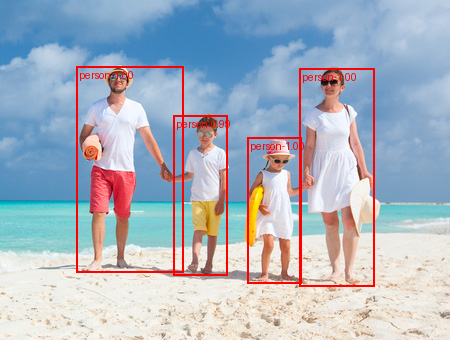

In [79]:
holiday_annot_labels_1 = ["{}-{:.2f}".format(label["name"], prob) for label, prob in zip(holiday_labels_1, holiday_preds_1[0]["scores"].detach().numpy())]

holiday_output_1 = draw_bounding_boxes(image=holiday_tensor_int[0],
                             boxes=holiday_preds_1[0]["boxes"],
                             labels=holiday_annot_labels_1,
                             colors=["red" if label["name"]=="person" else "green" for label in holiday_labels_1],
                             width=2
                            )

holiday_output_1.shape
to_pil_image(holiday_output_1)

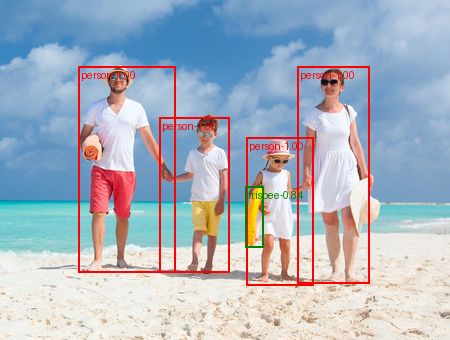

In [80]:
holiday_annot_labels_2 = ["{}-{:.2f}".format(label["name"], prob) for label, prob in zip(holiday_labels_2, holiday_preds_2[0]["scores"].detach().numpy())]

holiday_output_2 = draw_bounding_boxes(image=holiday_tensor_int[0],
                             boxes=holiday_preds_2[0]["boxes"],
                             labels=holiday_annot_labels_2,
                             colors=["red" if label["name"]=="person" else "green" for label in holiday_labels_2],
                             width=2
                            )

holiday_output_2.shape
to_pil_image(holiday_output_2)

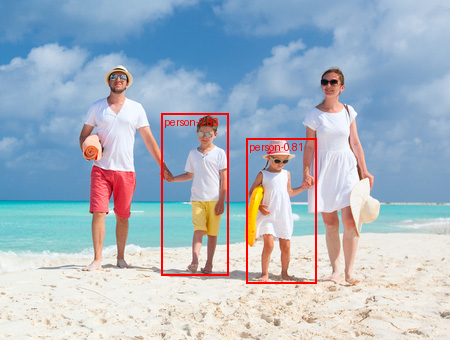

In [81]:
holiday_annot_labels_3 = ["{}-{:.2f}".format(label["name"], prob) for label, prob in zip(holiday_labels_3, holiday_preds_3[0]["scores"].detach().numpy())]

holiday_output_3 = draw_bounding_boxes(image=holiday_tensor_int[0],
                             boxes=holiday_preds_3[0]["boxes"],
                             labels=holiday_annot_labels_3,
                             colors=["red" if label["name"]=="person" else "green" for label in holiday_labels_3],
                             width=2
                            )

holiday_output_3.shape
to_pil_image(holiday_output_3)

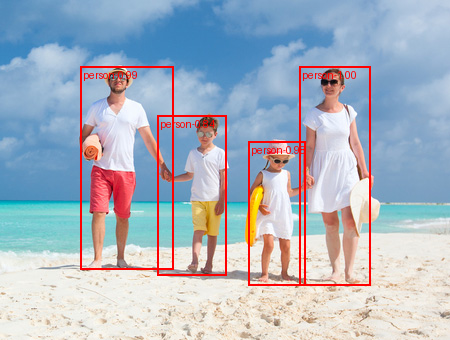

In [82]:
holiday_annot_labels_4 = ["{}-{:.2f}".format(label["name"], prob) for label, prob in zip(holiday_labels_4, holiday_preds_4[0]["scores"].detach().numpy())]

holiday_output_4 = draw_bounding_boxes(image=holiday_tensor_int[0],
                             boxes=holiday_preds_4[0]["boxes"],
                             labels=holiday_annot_labels_4,
                             colors=["red" if label["name"]=="person" else "green" for label in holiday_labels_4],
                             width=2
                            )

holiday_output_4.shape
to_pil_image(holiday_output_4)

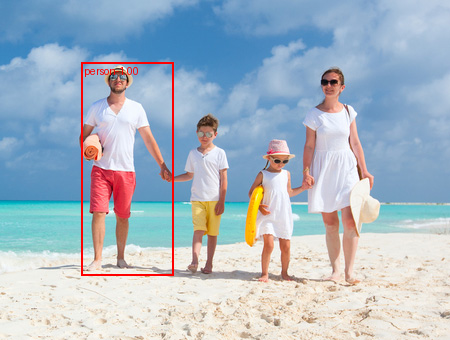

In [83]:
holiday_annot_labels_5 = ["{}-{:.2f}".format(label["name"], prob) for label, prob in zip(holiday_labels_5, holiday_preds_5[0]["scores"].detach().numpy())]

holiday_output_5 = draw_bounding_boxes(image=holiday_tensor_int[0],
                             boxes=holiday_preds_5[0]["boxes"],
                             labels=holiday_annot_labels_5,
                             colors=["red" if label["name"]=="person" else "green" for label in holiday_labels_5],
                             width=2
                            )

holiday_output_5.shape
to_pil_image(holiday_output_5)

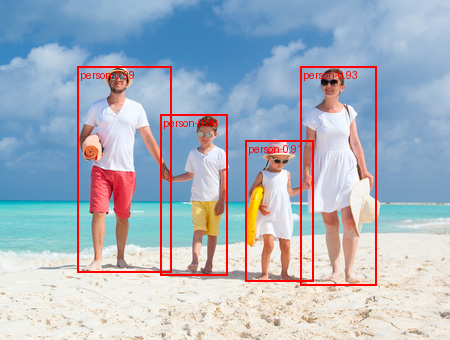

In [84]:
holiday_annot_labels_6 = ["{}-{:.2f}".format(label["name"], prob) for label, prob in zip(holiday_labels_6, holiday_preds_6[0]["scores"].detach().numpy())]

holiday_output_6 = draw_bounding_boxes(image=holiday_tensor_int[0],
                             boxes=holiday_preds_6[0]["boxes"],
                             labels=holiday_annot_labels_6,
                             colors=["red" if label["name"]=="person" else "green" for label in holiday_labels_6],
                             width=2
                            )

holiday_output_6.shape
to_pil_image(holiday_output_6)

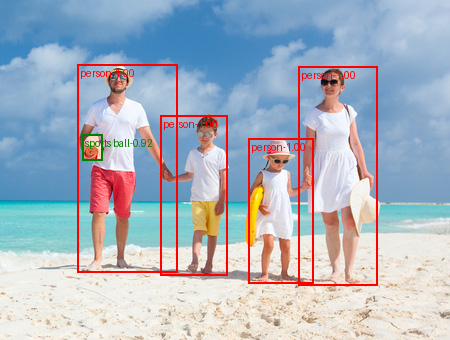

In [85]:
holiday_annot_labels_7 = ["{}-{:.2f}".format(label["name"], prob) for label, prob in zip(holiday_labels_7, holiday_preds_7[0]["scores"].detach().numpy())]

holiday_output_7 = draw_bounding_boxes(image=holiday_tensor_int[0],
                             boxes=holiday_preds_7[0]["boxes"],
                             labels=holiday_annot_labels_7,
                             colors=["red" if label["name"]=="person" else "green" for label in holiday_labels_7],
                             width=2
                            )

holiday_output_7.shape
to_pil_image(holiday_output_7)

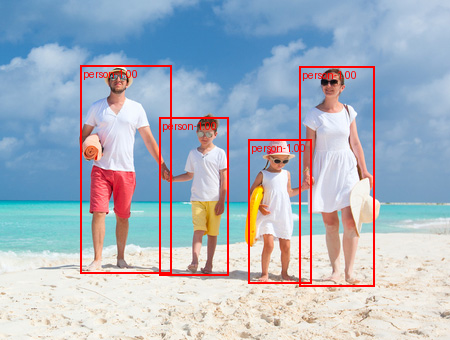

In [86]:
holiday_annot_labels_8 = ["{}-{:.2f}".format(label["name"], prob) for label, prob in zip(holiday_labels_8, holiday_preds_8[0]["scores"].detach().numpy())]

holiday_output_8 = draw_bounding_boxes(image=holiday_tensor_int[0],
                             boxes=holiday_preds_8[0]["boxes"],
                             labels=holiday_annot_labels_8,
                             colors=["red" if label["name"]=="person" else "green" for label in holiday_labels_8],
                             width=2
                            )

holiday_output_8.shape
to_pil_image(holiday_output_8)

/usr/local/lib/python3.12/dist-packages/torchvision/utils.py:367: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


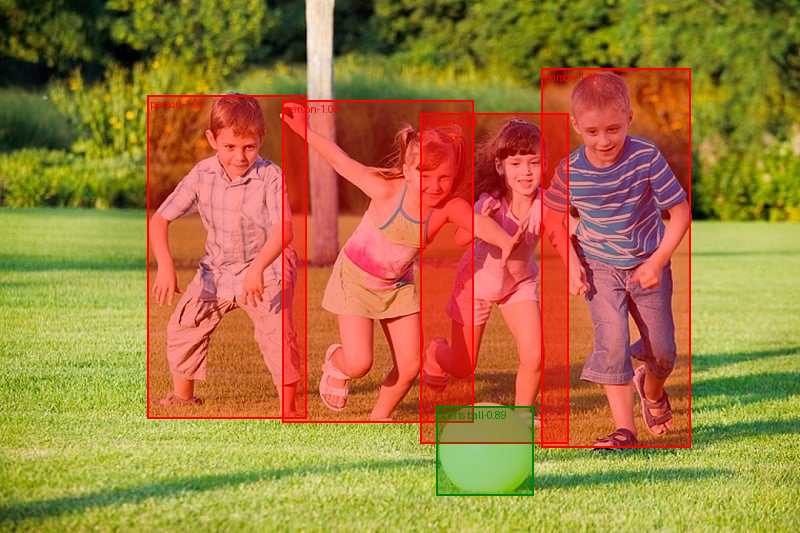

In [87]:
kids_annot_labels_1 = ["{}-{:.2f}".format(label["name"], prob) for label, prob in zip(kids_labels_1, kids_preds_1[0]["scores"].detach().numpy())]

kids_output_1 = draw_bounding_boxes(image=kids_playing_tensor_int[0],
                             boxes=kids_preds_1[0]["boxes"],
                             labels=kids_annot_labels_1,
                             colors=["red" if label["name"]=="person" else "green" for label in kids_labels_1],
                             width=2,
                             font_size=16,
                             fill=True
                            )
kids_output_1.shape
to_pil_image(kids_output_1)

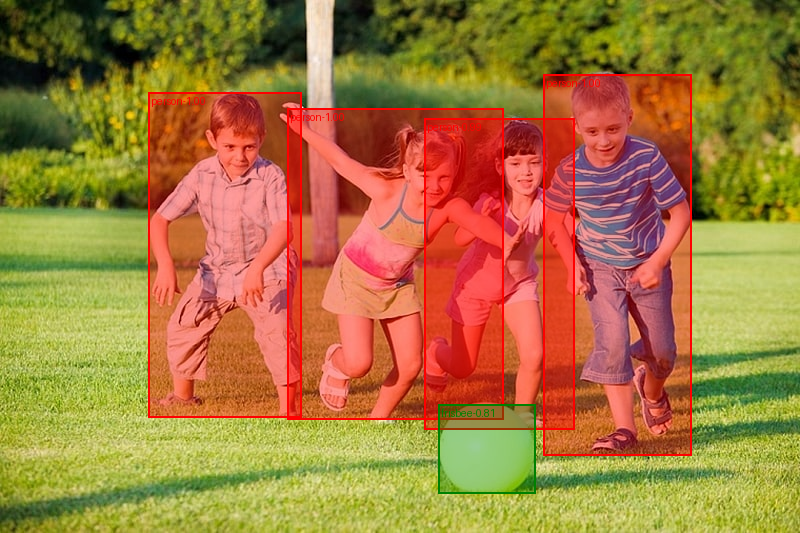

In [88]:
kids_annot_labels_2 = ["{}-{:.2f}".format(label["name"], prob) for label, prob in zip(kids_labels_2, kids_preds_2[0]["scores"].detach().numpy())]

kids_output_2 = draw_bounding_boxes(image=kids_playing_tensor_int[0],
                             boxes=kids_preds_2[0]["boxes"],
                             labels=kids_annot_labels_2,
                             colors=["red" if label["name"]=="person" else "green" for label in kids_labels_2],
                             width=2,
                             font_size=16,
                             fill=True
                            )
kids_output_2.shape
to_pil_image(kids_output_2)

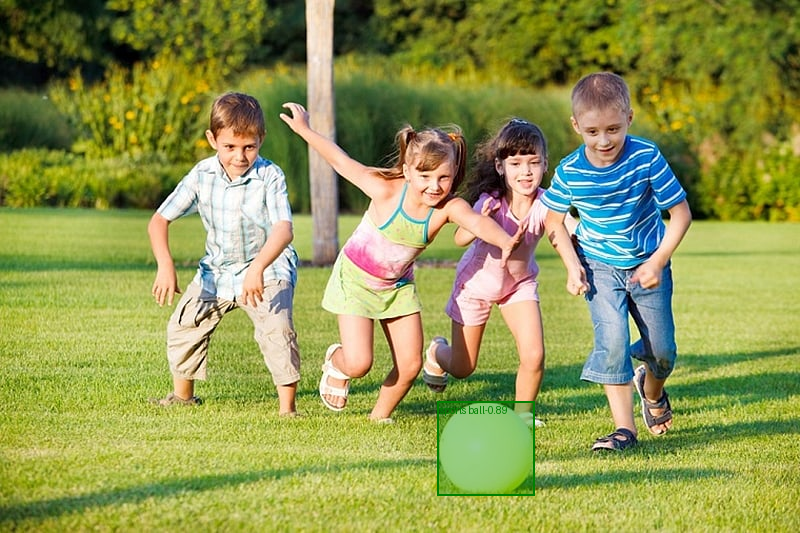

In [89]:
kids_annot_labels_3 = ["{}-{:.2f}".format(label["name"], prob) for label, prob in zip(kids_labels_3, kids_preds_3[0]["scores"].detach().numpy())]

kids_output_3 = draw_bounding_boxes(image=kids_playing_tensor_int[0],
                             boxes=kids_preds_3[0]["boxes"],
                             labels=kids_annot_labels_3,
                             colors=["red" if label["name"]=="person" else "green" for label in kids_labels_3],
                             width=2,
                             font_size=16,
                             fill=True
                            )
kids_output_3.shape
to_pil_image(kids_output_3)

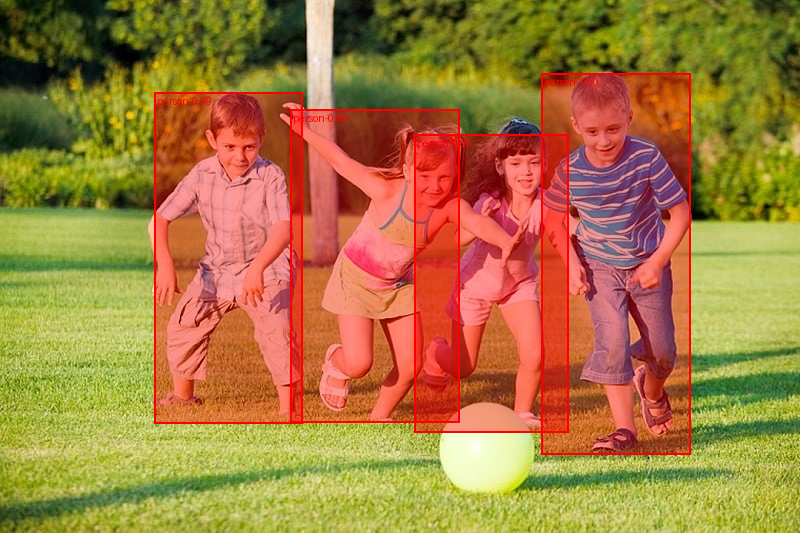

In [90]:
kids_annot_labels_4 = ["{}-{:.2f}".format(label["name"], prob) for label, prob in zip(kids_labels_4, kids_preds_4[0]["scores"].detach().numpy())]

kids_output_4 = draw_bounding_boxes(image=kids_playing_tensor_int[0],
                             boxes=kids_preds_4[0]["boxes"],
                             labels=kids_annot_labels_4,
                             colors=["red" if label["name"]=="person" else "green" for label in kids_labels_4],
                             width=2,
                             font_size=16,
                             fill=True
                            )
kids_output_4.shape
to_pil_image(kids_output_4)

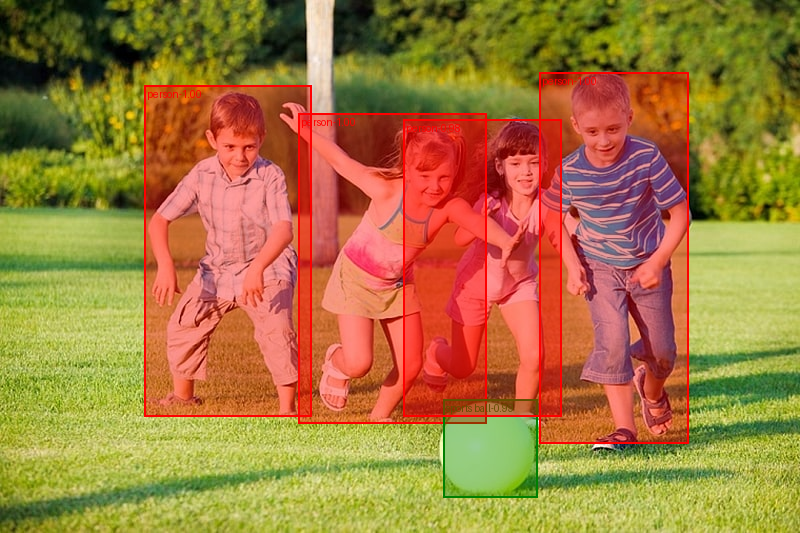

In [91]:
kids_annot_labels_5 = ["{}-{:.2f}".format(label["name"], prob) for label, prob in zip(kids_labels_5, kids_preds_5[0]["scores"].detach().numpy())]

kids_output_5 = draw_bounding_boxes(image=kids_playing_tensor_int[0],
                             boxes=kids_preds_5[0]["boxes"],
                             labels=kids_annot_labels_5,
                             colors=["red" if label["name"]=="person" else "green" for label in kids_labels_5],
                             width=2,
                             font_size=16,
                             fill=True
                            )
kids_output_5.shape
to_pil_image(kids_output_5)

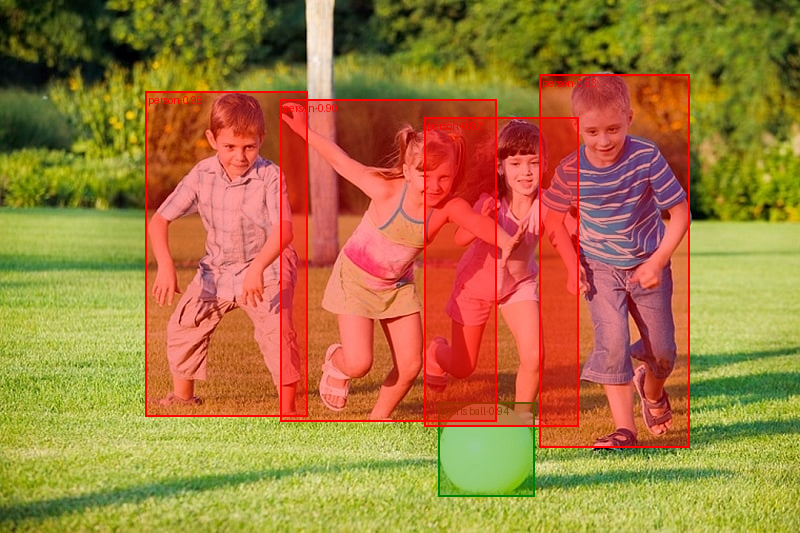

In [92]:
kids_annot_labels_6 = ["{}-{:.2f}".format(label["name"], prob) for label, prob in zip(kids_labels_6, kids_preds_6[0]["scores"].detach().numpy())]

kids_output_6 = draw_bounding_boxes(image=kids_playing_tensor_int[0],
                             boxes=kids_preds_6[0]["boxes"],
                             labels=kids_annot_labels_6,
                             colors=["red" if label["name"]=="person" else "green" for label in kids_labels_6],
                             width=2,
                             font_size=16,
                             fill=True
                            )
kids_output_6.shape
to_pil_image(kids_output_6)

/usr/local/lib/python3.12/dist-packages/torchvision/utils.py:367: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


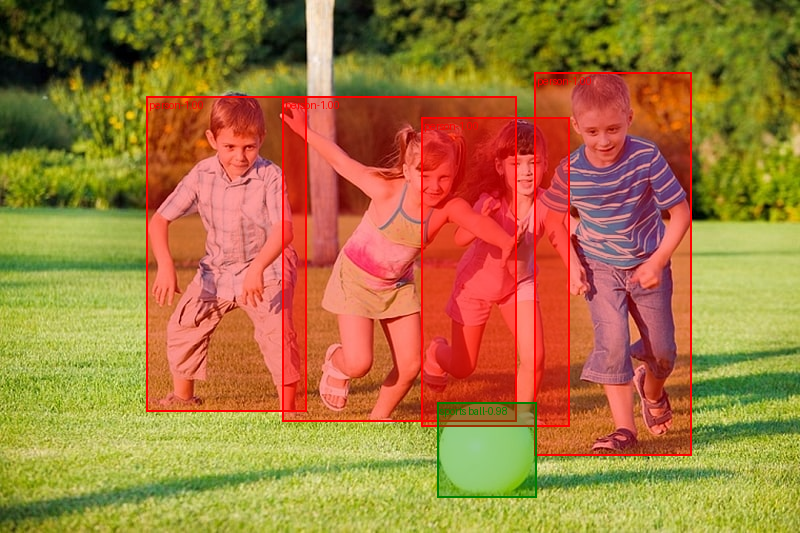

In [97]:
kids_annot_labels_7 = ["{}-{:.2f}".format(label["name"], prob) for label, prob in zip(kids_labels_7, kids_preds_7[0]["scores"].detach().numpy())]

kids_output_7 = draw_bounding_boxes(image=kids_playing_tensor_int[0],
                             boxes=kids_preds_7[0]["boxes"],
                             labels=kids_annot_labels_7,
                             colors=["red" if label["name"]=="person" else "green" for label in kids_labels_7],
                             width=2,
                             font_size=16,
                             fill=True
                            )
kids_output_7.shape
to_pil_image(kids_output_7)

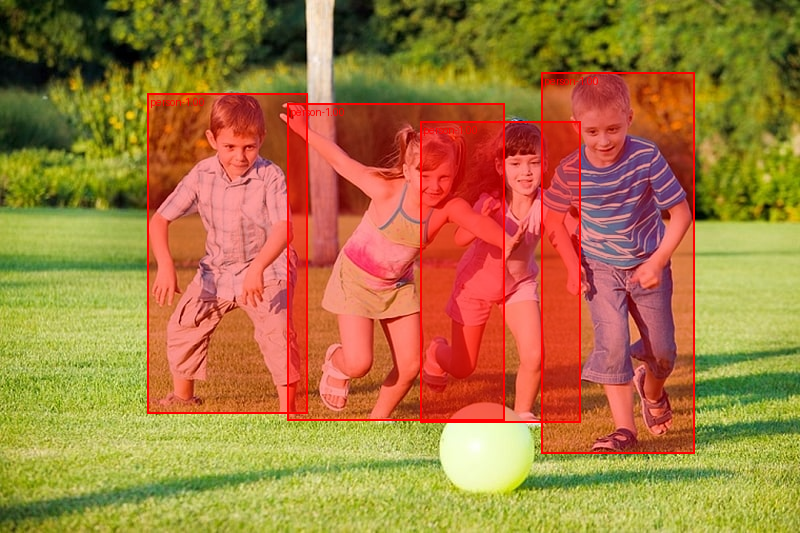

In [98]:
kids_annot_labels_8 = ["{}-{:.2f}".format(label["name"], prob) for label, prob in zip(kids_labels_8, kids_preds_8[0]["scores"].detach().numpy())]

kids_output_8 = draw_bounding_boxes(image=kids_playing_tensor_int[0],
                             boxes=kids_preds_8[0]["boxes"],
                             labels=kids_annot_labels_8,
                             colors=["red" if label["name"]=="person" else "green" for label in kids_labels_8],
                             width=2,
                             font_size=16,
                             fill=True
                            )
kids_output_8.shape
to_pil_image(kids_output_8)

### ***RESULTS:*** models, that shown the best results on photo1: fasterrcnn_resnet50_fpn (7 obljects), fasterrcnn_mobilenet_v3_large_fpn + maskrcnn_resnet50_fpn (5 objects), fasterrcnn_mobilenet_v3_large_320_fpn + fcos_resnet50_fpn + retinanet_resnet50_fpn + keypointrcnn_resnet50_fpn (4 right detected objects). The worst result were shown by models ssdlite320_mobilenet_v3_large and ssd300_vgg16.
### On photo 2: fasterrcnn_mobilenet_v3_large_320_fpn, fasterrcnn_mobilenet_v3_large_fpn, ssd300_vgg16, retinanet_resnet50_fpn, maskrcnn_resnet50_fpn, fasterrcnn_resnet50_fpn (5  objects), ssdlite320_mobilenet_v3_large, keypointrcnn_resnet50_fpn (4 objects). Worst results were shown by model fcos_resnet50_fpn (1 objects).
### Summary All Objects detection:
1. ssdlite320_mobilenet_v3_large            -> ✅ ДЕТЕКЦИЯ: 300 объектов
2. ssd300_vgg16                             -> ✅ ДЕТЕКЦИЯ: 200 объектов
3. retinanet_resnet50_fpn                   -> ✅ ДЕТЕКЦИЯ: 50 объектов
4. maskrcnn_resnet50_fpn                    -> ✅ ДЕТЕКЦИЯ: 14 объектов
5. fcos_resnet50_fpn                        -> ✅ ДЕТЕКЦИЯ: 14 объектов
6. fasterrcnn_mobilenet_v3_large_320_fpn    -> ✅ ДЕТЕКЦИЯ: 10 объектов
7. fasterrcnn_mobilenet_v3_large_fpn        -> ✅ ДЕТЕКЦИЯ: 10 объектов
8. fasterrcnn_resnet50_fpn                  -> ✅ ДЕТЕКЦИЯ: 8 объектов
9. keypointrcnn_resnet50_fpn                -> ✅ ДЕТЕКЦИЯ: 6 объектов
### BEST model on photo1: fasterrcnn_resnet50_fpn, WORST: ssdlite320_mobilenet_v3_large, ssd300_vgg16.
### BEST model on photo2: fasterrcnn_mobilenet_v3_large_320_fpn, fasterrcnn_mobilenet_v3_large_fpn, ssd300_vgg16, retinanet_resnet50_fpn, maskrcnn_resnet50_fpn, fasterrcnn_resnet50_fpn, WORST: fcos_resnet50_fpn.
### BEST model summary: fasterrcnn_resnet50_fpn (more confident) and detect more clear objects than other models, WORST model summary: ssdlite320_mobilenet_v3_large (detectes too many uncofident objects).